# Match 1
### EPL - *Chelsea vs. Newcatle United - March, 2022*

*Code Outline (Broken Down into 10-Minute Time Intervals):

- **Whole Network Visualization & Info**
- **Chelsea's Network Visualization & Performance Measures**
    - Passing Network Directed Graph
    - Interception Network Directed Graph
    - Degree Centrality
    - Betweenness Centrality
    - Closeness Centrality
    - Passing Network Denisty
    - Interception Network Density
    - Interception Ratio
    - Clustering Coefficient and Average
- **Newcastle's Network Visualization & Performance Measures**
    - Passing Network Directed Graph
    - Interception Network Directed Graph
    - Degree Centrality
    - Betweenness Centrality
    - Closeness Centrality
    - Passing Network Denisty
    - Interception Network Density
    - Interception Ratio
    - Clustering Coefficient and Average

----------------------------------------------------------------------
----------------------------------------------------------------------



## Database:

In [1]:
#All necessary packages
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import openpyxl as xl
from operator import itemgetter

#Importing all the necessary files (Excel file, specify sheet, soccer pitch for graph background)
On_Field_Players_Workbook_Format = xl.load_workbook("Collected Data of 2 Matches.xlsx")
Sheet = On_Field_Players_Workbook_Format["Match 1"]
Graph_Background = plt.imread("Soccer Pitch.jpg")

#Some global predefinitions

#Manually adding the nodes makes it easier to control which player gets what index so that way we can have all chelsea
#players at the beginning and all newcastle players at the end, rather than the nodes being automatically and randomly
# created when adding edges between nodes. Worse, is that sometimes nodes are not created at all when the node has no edges
# at all with any other  node (the player was inactive), plus it's useful because it allows us to assign the node 
# colors more easily when we know that the first 11 indexes will all be skyblue and last 11 indexes will all be red 
# rather than mixed up and random which takes time to supervise

Node_Set_All_Players_1st_Half = [
("16 Mendy" , {"pos" : (8, 40)}),
("14 Chalobah" , {"pos" : (22, 15)}),
("4 Christensen" , {"pos" : (22, 30)}),
("2 Rudiger" , {"pos" : (22, 50)}),
("22 Ziyech" , {"pos" : (52, 22.5)}),
("5 Jorginho" , {"pos" : (38, 40)}),
("7 Kante" , {"pos" : (38, 22.5)}),
("31 Sarr" , {"pos" : (22, 65)}),
("19 Mount" , {"pos" : (38, 57.5)}) ,
("29 Havertz" , {"pos" : (52, 40)}) ,
("11 Werner" , {"pos" : (52, 57.5)}) ,
("1 Dubravka", {"pos" : (112, 40)}),
("5 Schar" , {"pos" : (98, 40)}),
("6 Lascelles" , {"pos" : (98, 55)}),
("33 Burn" , {"pos" : (98, 25)}),
("19 Manquillo" , {"pos" : (98, 70)}),
("36 Longstaff" , {"pos" : (82, 50)}),
("39 Guimaraes", {"pos" : (82, 30)}),
("13 Targett", {"pos" : (98, 10)}),
("23 Murphy", {"pos" : (82, 15)}),
("20 Wood", {"pos" : (68, 40)}), 
("24 Almiron", {"pos" : (82, 65)})
]

Chelsea_Players_1st_Half = [
("16 Mendy" , {"pos" : (8, 40)}),
("14 Chalobah" , {"pos" : (22, 15)}),
("4 Christensen" , {"pos" : (22, 30)}),
("2 Rudiger" , {"pos" : (22, 50)}),
("22 Ziyech" , {"pos" : (52, 22.5)}),
("5 Jorginho" , {"pos" : (38, 40)}),
("7 Kante" , {"pos" : (38, 22.5)}),
("31 Sarr" , {"pos" : (22, 65)}),
("19 Mount" , {"pos" : (38, 57.5)}) ,
("29 Havertz" , {"pos" : (52, 40)}) ,
("11 Werner" , {"pos" : (52, 57.5)})   
]

Newcastle_Players_1st_Half = [
("1 Dubravka", {"pos" : (112, 40)}),
("5 Schar" , {"pos" : (98, 40)}),
("6 Lascelles" , {"pos" : (98, 55)}),
("33 Burn" , {"pos" : (98, 25)}),
("19 Manquillo" , {"pos" : (98, 70)}),
("36 Longstaff" , {"pos" : (82, 50)}),
("39 Guimaraes", {"pos" : (82, 30)}),
("13 Targett", {"pos" : (98, 10)}),
("23 Murphy", {"pos" : (82, 15)}),
("20 Wood", {"pos" : (68, 40)}), 
("24 Almiron", {"pos" : (82, 65)})   
]

#Needed because teams switch sides on pitch in the 2nd half
#Note that several substitutions occur in 2nd half so we need several lists to accurately represent the players on field
#If we added all players and their substitutions to one list then first of all we will have an incorrect number of 
#nodes in the network graph -it should always not exceed 22- second of all there will be several nodes with the same position
#which means on the graph they will be on top of one another and so the node labels would be messy scratch

Node_Set_All_Players_2nd_Half_Time_45_50_60 = [
("16 Mendy" , {"pos" : (112, 40)}),
("14 Chalobah" , {"pos" : (98, 65)}),
("4 Christensen" , {"pos" : (98, 50)}),
("2 Rudiger" , {"pos" : (98, 30)}),
("22 Ziyech" , {"pos" : (68, 57.5)}),
("5 Jorginho" , {"pos" : (82, 40)}),
("7 Kante" , {"pos" : (82, 57.5)}),
("31 Sarr" , {"pos" : (98, 15)}),
("19 Mount" , {"pos" : (82, 22.5)}) ,
("29 Havertz" , {"pos" : (68, 40)}) ,
("11 Werner" , {"pos" : (68, 22.5)}) ,
("1 Dubravka", {"pos" : (8, 40)}),
("5 Schar" , {"pos" : (22, 40)}),
("6 Lascelles" , {"pos" : (22, 25)}),
("33 Burn" , {"pos" : (22, 55)}),
("19 Manquillo" , {"pos" : (22, 10)}),
("36 Longstaff" , {"pos" : (38, 30)}),
("39 Guimaraes", {"pos" : (38, 50)}),
("13 Targett", {"pos" : (22, 70)}),
("23 Murphy", {"pos" : (38, 65)}),
("20 Wood", {"pos" : (52, 40)}), 
("24 Almiron", {"pos" : (38, 15)})
]

Chelsea_Players_2nd_Half_Time_45_50_60 = [
("16 Mendy" , {"pos" : (112, 40)}),
("14 Chalobah" , {"pos" : (98, 65)}),
("4 Christensen" , {"pos" : (98, 50)}),
("2 Rudiger" , {"pos" : (98, 30)}),
("22 Ziyech" , {"pos" : (68, 57.5)}),
("5 Jorginho" , {"pos" : (82, 40)}),
("7 Kante" , {"pos" : (82, 57.5)}),
("31 Sarr" , {"pos" : (98, 15)}),
("19 Mount" , {"pos" : (82, 22.5)}) ,
("29 Havertz" , {"pos" : (68, 40)}) ,
("11 Werner" , {"pos" : (68, 22.5)})
]

Newcastle_Players_2nd_Half_Time_45_50_60 = [
("1 Dubravka", {"pos" : (8, 40)}),
("5 Schar" , {"pos" : (22, 40)}),
("6 Lascelles" , {"pos" : (22, 25)}),
("33 Burn" , {"pos" : (22, 55)}),
("19 Manquillo" , {"pos" : (22, 10)}),
("36 Longstaff" , {"pos" : (38, 30)}),
("39 Guimaraes", {"pos" : (38, 50)}),
("13 Targett", {"pos" : (22, 70)}),
("23 Murphy", {"pos" : (38, 65)}),
("20 Wood", {"pos" : (52, 40)}), 
("24 Almiron", {"pos" : (38, 15)})
]

Node_Set_All_Players_2nd_Half_Time_60_70 = [
("16 Mendy" , {"pos" : (112, 40)}),
("14 Chalobah" , {"pos" : (98, 65)}),
("4 Christensen" , {"pos" : (98, 50)}),
("2 Rudiger" , {"pos" : (98, 30)}),
("22 Ziyech" , {"pos" : (68, 57.5)}),
("5 Jorginho" , {"pos" : (82, 40)}),
("7 Kante" , {"pos" : (82, 57.5)}),
("31 Sarr" , {"pos" : (98, 15)}),
("19 Mount - 8 Kovacic" , {"pos" : (82, 22.5)}),
("29 Havertz" , {"pos" : (68, 40)}) ,
("11 Werner - 9 Lukaku" , {"pos" : (68, 22.5)}),
("1 Dubravka", {"pos" : (8, 40)}),
("5 Schar" , {"pos" : (22, 40)}),
("6 Lascelles" , {"pos" : (22, 25)}),
("33 Burn" , {"pos" : (22, 55)}),
("19 Manquillo" , {"pos" : (22, 10)}),
("36 Longstaff" , {"pos" : (38, 30)}),
("39 Guimaraes", {"pos" : (38, 50)}),
("13 Targett", {"pos" : (22, 70)}),
("23 Murphy", {"pos" : (38, 65)}),
("20 Wood", {"pos" : (52, 40)}), 
("24 Almiron - 10 Saint-Maximin" , {"pos" : (38, 15)})
]

Chelsea_Players_2nd_Half_Time_60_70 = [
("16 Mendy" , {"pos" : (112, 40)}),
("14 Chalobah" , {"pos" : (98, 65)}),
("4 Christensen" , {"pos" : (98, 50)}),
("2 Rudiger" , {"pos" : (98, 30)}),
("22 Ziyech" , {"pos" : (68, 57.5)}),
("5 Jorginho" , {"pos" : (82, 40)}),
("7 Kante" , {"pos" : (82, 57.5)}),
("31 Sarr" , {"pos" : (98, 15)}),
("19 Mount - 8 Kovacic" , {"pos" : (82, 22.5)}),
("29 Havertz" , {"pos" : (68, 40)}) ,
("11 Werner - 9 Lukaku" , {"pos" : (68, 22.5)})
]

Newcastle_Players_2nd_Half_Time_60_70 = [
("1 Dubravka", {"pos" : (8, 40)}),
("5 Schar" , {"pos" : (22, 40)}),
("6 Lascelles" , {"pos" : (22, 25)}),
("33 Burn" , {"pos" : (22, 55)}),
("19 Manquillo" , {"pos" : (22, 10)}),
("36 Longstaff" , {"pos" : (38, 30)}),
("39 Guimaraes", {"pos" : (38, 50)}),
("13 Targett", {"pos" : (22, 70)}),
("23 Murphy", {"pos" : (38, 65)}),
("20 Wood", {"pos" : (52, 40)}), 
("24 Almiron - 10 Saint-Maximin" , {"pos" : (38, 15)})
]
    
    
Node_Set_All_Players_2nd_Half_Time_70_80 = [
("16 Mendy" , {"pos" : (112, 40)}),
("14 Chalobah" , {"pos" : (98, 65)}),
("4 Christensen" , {"pos" : (98, 50)}),
("2 Rudiger" , {"pos" : (98, 30)}),
("22 Ziyech" , {"pos" : (68, 57.5)}),
("5 Jorginho" , {"pos" : (82, 40)}),
("7 Kante" , {"pos" : (82, 57.5)}),
("31 Sarr - 10 Pulisic" , {"pos" : (98, 15)}),
("8 Kovacic" , {"pos" : (82, 22.5)}),
("29 Havertz" , {"pos" : (68, 40)}) ,
("9 Lukaku" , {"pos" : (68, 22.5)}),
("1 Dubravka", {"pos" : (8, 40)}),
("5 Schar" , {"pos" : (22, 40)}),
("6 Lascelles" , {"pos" : (22, 25)}),
("33 Burn" , {"pos" : (22, 55)}),
("19 Manquillo" , {"pos" : (22, 10)}),
("36 Longstaff" , {"pos" : (38, 30)}),
("39 Guimaraes", {"pos" : (38, 50)}),
("13 Targett", {"pos" : (22, 70)}),
("23 Murphy", {"pos" : (38, 65)}),
("20 Wood", {"pos" : (52, 40)}), 
("10 Saint-Maximin" ,{"pos" : (38, 15)}),
]
    
Chelsea_Players_2nd_Half_Time_70_80 = [
("16 Mendy" , {"pos" : (112, 40)}),
("14 Chalobah" , {"pos" : (98, 65)}),
("4 Christensen" , {"pos" : (98, 50)}),
("2 Rudiger" , {"pos" : (98, 30)}),
("22 Ziyech" , {"pos" : (68, 57.5)}),
("5 Jorginho" , {"pos" : (82, 40)}),
("7 Kante" , {"pos" : (82, 57.5)}),
("31 Sarr - 10 Pulisic" , {"pos" : (98, 15)}),
("8 Kovacic" , {"pos" : (82, 22.5)}),
("29 Havertz" , {"pos" : (68, 40)}) ,
("9 Lukaku" , {"pos" : (68, 22.5)})   
]
    
Newcastle_Players_2nd_Half_Time_70_80 = [   
("1 Dubravka", {"pos" : (8, 40)}),
("5 Schar" , {"pos" : (22, 40)}),
("6 Lascelles" , {"pos" : (22, 25)}),
("33 Burn" , {"pos" : (22, 55)}),
("19 Manquillo" , {"pos" : (22, 10)}),
("36 Longstaff" , {"pos" : (38, 30)}),
("39 Guimaraes", {"pos" : (38, 50)}),
("13 Targett", {"pos" : (22, 70)}),
("23 Murphy", {"pos" : (38, 65)}),
("20 Wood", {"pos" : (52, 40)}), 
("10 Saint-Maximin" ,{"pos" : (38, 15)})   
]
    
    
Node_Set_All_Players_2nd_Half_Time_80_90 = [
("16 Mendy" , {"pos" : (112, 40)}),
("14 Chalobah" , {"pos" : (98, 65)}),
("4 Christensen" , {"pos" : (98, 50)}),
("2 Rudiger" , {"pos" : (98, 30)}),
("22 Ziyech" , {"pos" : (68, 57.5)}),
("5 Jorginho" , {"pos" : (82, 40)}),
("7 Kante" , {"pos" : (82, 57.5)}),
("10 Pulisic" , {"pos" : (98, 15)}),
("8 Kovacic" , {"pos" : (82, 22.5)}),
("29 Havertz" , {"pos" : (68, 40)}) ,
("9 Lukaku" , {"pos" : (68, 22.5)}),
("1 Dubravka", {"pos" : (8, 40)}),
("5 Schar" , {"pos" : (22, 40)}),
("6 Lascelles" , {"pos" : (22, 25)}),
("33 Burn" , {"pos" : (22, 55)}),
("19 Manquillo" , {"pos" : (22, 10)}),
("36 Longstaff" , {"pos" : (38, 30)}),
("39 Guimaraes", {"pos" : (38, 50)}),
("13 Targett", {"pos" : (22, 70)}),
("23 Murphy", {"pos" : (38, 65)}),
("20 Wood", {"pos" : (52, 40)}), 
("10 Saint-Maximin" ,{"pos" : (38, 15)})  
]
    
Chelsea_Players_2nd_Half_Time_80_90 = [
("16 Mendy" , {"pos" : (112, 40)}),
("14 Chalobah" , {"pos" : (98, 65)}),
("4 Christensen" , {"pos" : (98, 50)}),
("2 Rudiger" , {"pos" : (98, 30)}),
("22 Ziyech" , {"pos" : (68, 57.5)}),
("5 Jorginho" , {"pos" : (82, 40)}),
("7 Kante" , {"pos" : (82, 57.5)}),
("10 Pulisic" , {"pos" : (98, 15)}),
("8 Kovacic" , {"pos" : (82, 22.5)}),
("29 Havertz" , {"pos" : (68, 40)}) ,
("9 Lukaku" , {"pos" : (68, 22.5)})   
]
    
Newcastle_Players_2nd_Half_Time_80_90 = [ 
("1 Dubravka", {"pos" : (8, 40)}),
("5 Schar" , {"pos" : (22, 40)}),
("6 Lascelles" , {"pos" : (22, 25)}),
("33 Burn" , {"pos" : (22, 55)}),
("19 Manquillo" , {"pos" : (22, 10)}),
("36 Longstaff" , {"pos" : (38, 30)}),
("39 Guimaraes", {"pos" : (38, 50)}),
("13 Targett", {"pos" : (22, 70)}),
("23 Murphy", {"pos" : (38, 65)}),
("20 Wood", {"pos" : (52, 40)}), 
("10 Saint-Maximin" ,{"pos" : (38, 15)})   
]
    
    
Node_Set_All_Players_2nd_Half_Time_90_94 = [
("16 Mendy" , {"pos" : (112, 40)}),
("14 Chalobah" , {"pos" : (98, 65)}),
("4 Christensen" , {"pos" : (98, 50)}),
("2 Rudiger" , {"pos" : (98, 30)}),
("22 Ziyech" , {"pos" : (68, 57.5)}),
("5 Jorginho" , {"pos" : (82, 40)}),
("7 Kante" , {"pos" : (82, 57.5)}),
("10 Pulisic" , {"pos" : (98, 15)}),
("8 Kovacic" , {"pos" : (82, 22.5)}),
("29 Havertz" , {"pos" : (68, 40)}) ,
("9 Lukaku" , {"pos" : (68, 22.5)}),
("1 Dubravka", {"pos" : (8, 40)}),
("5 Schar" , {"pos" : (22, 40)}),
("6 Lascelles" , {"pos" : (22, 25)}),
("33 Burn" , {"pos" : (22, 55)}),
("19 Manquillo - 21 Fraser" , {"pos" : (22, 10)}),
("36 Longstaff" , {"pos" : (38, 30)}),
("39 Guimaraes", {"pos" : (38, 50)}),
("13 Targett", {"pos" : (22, 70)}),
("23 Murphy - 34 Gayle" , {"pos" : (38, 65)}),
("20 Wood", {"pos" : (52, 40)}), 
("10 Saint-Maximin" ,{"pos" : (38, 15)})
]
    
Chelsea_Players_2nd_Half_Time_90_94 = [
("16 Mendy" , {"pos" : (112, 40)}),
("14 Chalobah" , {"pos" : (98, 65)}),
("4 Christensen" , {"pos" : (98, 50)}),
("2 Rudiger" , {"pos" : (98, 30)}),
("22 Ziyech" , {"pos" : (68, 57.5)}),
("5 Jorginho" , {"pos" : (82, 40)}),
("7 Kante" , {"pos" : (82, 57.5)}),
("10 Pulisic" , {"pos" : (98, 15)}),
("8 Kovacic" , {"pos" : (82, 22.5)}),
("29 Havertz" , {"pos" : (68, 40)}) ,
("9 Lukaku" , {"pos" : (68, 22.5)})
]
    
Newcastle_Players_2nd_Half_Time_90_94 = [ 
("1 Dubravka", {"pos" : (8, 40)}),
("5 Schar" , {"pos" : (22, 40)}),
("6 Lascelles" , {"pos" : (22, 25)}),
("33 Burn" , {"pos" : (22, 55)}),
("19 Manquillo - 21 Fraser" , {"pos" : (22, 10)}),
("36 Longstaff" , {"pos" : (38, 30)}),
("39 Guimaraes", {"pos" : (38, 50)}),
("13 Targett", {"pos" : (22, 70)}),
("23 Murphy - 34 Gayle" , {"pos" : (38, 65)}),
("20 Wood", {"pos" : (52, 40)}), 
("10 Saint-Maximin" ,{"pos" : (38, 15)})   
]


## Base Code

In [2]:
def Whole_Passing_Network (
    Which_Half,
    Time_Interval_String,  
    Whole_Table_Excel_Index_Row_Start_IncludedinRange,
    Whole_Table_Excel_Index_Row_End_ExcludedfromRange,
    Whole_Table_Excel_Index_Column_Start_IncludedinRange,
    Whole_Table_Excel_Index_Column_End_ExcludedfromRange) :
    
    print ("View of Overall Network")
    print ("")

    #Initializing the graph
    Whole_Passing_Network = nx.DiGraph()
    
    #Adding nodes
    #We have decided to use multiple if statements rather than if-elif-else because they generated errors
    #This long chain of ands is equivalent to if and only if but we didn't think of it at the time
    
    if (Which_Half == "1st Half"
        and Which_Half != "2nd Half" 
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Whole_Passing_Network.add_nodes_from(Node_Set_All_Players_1st_Half)

    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "45 → 50 Minutes" or "50 → 60 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Whole_Passing_Network.add_nodes_from(Node_Set_All_Players_2nd_Half_Time_45_50_60)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "60 → 70 Minutes" 
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Whole_Passing_Network.add_nodes_from(Node_Set_All_Players_2nd_Half_Time_60_70)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "70 → 80 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Whole_Passing_Network.add_nodes_from(Node_Set_All_Players_2nd_Half_Time_70_80)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "80 → 90 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Whole_Passing_Network.add_nodes_from(Node_Set_All_Players_2nd_Half_Time_80_90)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "90 → 94 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"):
        Whole_Passing_Network.add_nodes_from(Node_Set_All_Players_2nd_Half_Time_90_94)
        
    
    
    #Adding edges
    for row in range(Whole_Table_Excel_Index_Row_Start_IncludedinRange, Whole_Table_Excel_Index_Row_End_ExcludedfromRange):    
        for column in range(Whole_Table_Excel_Index_Column_Start_IncludedinRange, Whole_Table_Excel_Index_Column_End_ExcludedfromRange):   
            edge=Sheet.cell(row,column).value
            if (edge!=0):
                Whole_Passing_Network.add_edge(Sheet.cell(row,3).value,Sheet.cell(Whole_Table_Excel_Index_Row_Start_IncludedinRange-1,column).value, weight = edge) 

    #Displaying graph
    
    #Needed because node_color parameter in nx.draw functiom only accepts lists so we cannot add it
    #to the dictionary of player attributes

    color_map = [] 
    for index, node in enumerate(Whole_Passing_Network.nodes()):
        if index < 11:
            color_map.append('skyblue')
        else: 
            color_map.append('red')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    nx.draw(
    Whole_Passing_Network,
    with_labels = True, 
    edge_color='Yellow',
    node_color = color_map,
    pos = nx.get_node_attributes(Whole_Passing_Network, 'pos'),
    node_size=1400, 
    font_family = "Times New Roman", 
    font_color = "black",
    font_size = 15,
    font_weight = "bold")

    nx.draw_networkx_edge_labels(
    Whole_Passing_Network, 
    pos = nx.get_node_attributes(Whole_Passing_Network, 'pos'), 
    edge_labels=nx.get_edge_attributes(Whole_Passing_Network, 'weight'))

    ax.set_axis_on()
    ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
    ax.imshow(Graph_Background, extent = [0.0, 120.0, 0.0, 80.0])
    plt.title("\nChelsea vs. Newcastle United \n (4-3-3)                     (5-4-1)\n ----------------------------------------------------- \n\n", color = "red", size = 25, font = "Times New Roman")
    plt.suptitle("\nPassing Network \n" + Time_Interval_String , color = "Black", size = 20, font = "Times New Roman", style = "italic")
    plt.show()
    
    #Sanity checks
    #Specifically making sure the ranges set in the for loops are correct
    #Lists as too long so they will be slotted as commentary unless needed for review of data
    
    print ("")
    print("Total number of nodes: ", int(Whole_Passing_Network.number_of_nodes())) 
    #Should be same as total number of players on field
    print ("")
    print("Total number of edges: ", int(Whole_Passing_Network.number_of_edges()))
    print("Not to be confused with the total number of interceptions because these edges have weights.")
    
    print ("")
    #print("List of all nodes: ", list(Whole_Passing_Network.nodes())) 
    #print ("")
    #print("List of all edges: ", list(Whole_Passing_Network.edges(data = True)))
    #print ("")
    #print("Degree for all nodes: ", dict(Whole_Passing_Network.degree()))
    #print ("")
    #print("In Degree for all nodes: ", dict(Whole_Passing_Network.in_degree()))
    
    All_passes = dict(nx.get_edge_attributes(Whole_Passing_Network, 'weight'))
    
    passes = []
    for node in All_passes:
        for key, value in All_passes.items():
            if key == node:
                passes.append(value)
    print("The total number of passes that occured on field throughout this time interval = " + str(sum(passes)))
    print("")
    

def Chelsea_Performance_Visualization_and_Measures (
    Which_Half,
    Time_Interval_String,
    Passing_Table_Excel_Index_Row_Start_IncludedinRange,
    Passing_Table_Excel_Index_Row_End_ExcludedfromRange,
    Passing_Table_Excel_Index_Column_Start_IncludedinRange,
    Passing_Table_Excel_Index_Column_End_ExcludedfromRange,
    Interception_Table_Excel_Index_Row_Start_IncludedinRange,
    Interception_Table_Excel_Index_Row_End_ExcludedfromRange,
    Interception_Table_Excel_Index_Column_Start_IncludedinRange,
    Interception_Table_Excel_Index_Column_End_ExcludedfromRange) :
    
    print ("View of Chelsea's Network")
    print ("")
    
    #### For the Passing Network :
    
    #Initializing the graph
    Chelsea_Network = nx.DiGraph()
            
    #Adding nodes
    if (Which_Half == "1st Half" 
        and Which_Half != "2nd Half" 
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Chelsea_Network.add_nodes_from(Chelsea_Players_1st_Half)

    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "45 → 50 Minutes" or "50 → 60 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Chelsea_Network.add_nodes_from(Chelsea_Players_2nd_Half_Time_45_50_60)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "60 → 70 Minutes" 
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Chelsea_Network.add_nodes_from(Chelsea_Players_2nd_Half_Time_60_70)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "70 → 80 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Chelsea_Network.add_nodes_from(Chelsea_Players_2nd_Half_Time_70_80)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "80 → 90 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Chelsea_Network.add_nodes_from(Chelsea_Players_2nd_Half_Time_80_90)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "90 → 94 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"):
        Chelsea_Network.add_nodes_from(Chelsea_Players_2nd_Half_Time_90_94)

    #Adding edges
    for row in range(Passing_Table_Excel_Index_Row_Start_IncludedinRange, Passing_Table_Excel_Index_Row_End_ExcludedfromRange):    
        for column in range(Passing_Table_Excel_Index_Column_Start_IncludedinRange, Passing_Table_Excel_Index_Column_End_ExcludedfromRange):   
            edge=Sheet.cell(row,column).value
            if (edge!=0):
                Chelsea_Network.add_edge(Sheet.cell(row,3).value,Sheet.cell(Passing_Table_Excel_Index_Row_Start_IncludedinRange-1,column).value, weight = edge) 

    
    #Displaying graph
    fig, ax = plt.subplots(figsize=(20, 10))
    
    nx.draw(
    Chelsea_Network,
    with_labels = True, 
    edge_color='Yellow',
    node_color = "skyblue",
    pos = nx.get_node_attributes(Chelsea_Network, 'pos'),
    node_size=1400, 
    font_family = "Times New Roman", 
    font_color = "black",
    font_size = 15,
    font_weight = "bold")

    nx.draw_networkx_edge_labels(
    Chelsea_Network, 
    pos = nx.get_node_attributes(Chelsea_Network, 'pos'), 
    edge_labels=nx.get_edge_attributes(Chelsea_Network, 'weight'))

    ax.set_axis_on()
    ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
    ax.imshow(Graph_Background, extent = [0.0, 120.0, 0.0, 80.0])
    plt.title("\nChelsea Network \n" + Time_Interval_String + "\n ----------------------------------------------------- \n\n", color = "skyblue", size = 25, font = "Times New Roman")
    plt.show()
    
    #Sanity checks
    print ("")
    print("Total number of nodes: ", int(Chelsea_Network.number_of_nodes())) 
    #Should be same as total number of players on field
    print ("")
    print("Total number of edges: ", int(Chelsea_Network.number_of_edges()))
    #Not to be confused with the total number of interceptions because these edges have weights.
    
    print ("")
    #print("List of all nodes: ", list(Chelsea_Network.nodes())) 
    #print ("")
    #print("List of all edges: ", list(Chelsea_Network.edges(data = True)))
    #print ("")
    #print("Degree for all nodes: ", dict(Chelsea_Network.degree()))
    #print ("")
    
    #Calculations :
    
    # - Network Density
    print("")
    density = nx.density(Chelsea_Network)
    print("Passing Network Density = ", density)
    print("")
    
    # - Degree Centrality
    degree_dict = dict(Chelsea_Network.degree(Chelsea_Network.nodes()))
    nx.set_node_attributes(Chelsea_Network, degree_dict, 'degree')
    sorted_degree = sorted(degree_dict.items(), key=itemgetter(1), reverse=True)
    top_degree = sorted_degree[:11]
    for td in top_degree:
        degree = degree_dict[td[0]]
        print("Player: ", td[0], " | Degree Centrality: ", td[1])
    print("")
    
    # - Betweenness Centrality 
    betweenness_dict = nx.betweenness_centrality(Chelsea_Network) 
    nx.set_node_attributes(Chelsea_Network, betweenness_dict, 'betweenness')
    sorted_betweenness = sorted(betweenness_dict.items(), key=itemgetter(1), reverse=True)
    top_betweenness = sorted_betweenness[:11]
    for tb in top_betweenness: # Loop through top_betweenness
        degree = degree_dict[tb[0]] # Use degree_dict to access a node's degree, see footnote 2
        print("Player: ", tb[0], "| Betweenness Centrality: ", tb[1], " | Degree: ", degree)
    print("")
    
    # - Closeness Centrality
    closeness_dict = nx.closeness_centrality(Chelsea_Network)
    nx.set_node_attributes(Chelsea_Network, closeness_dict, 'closeness')
    sorted_closeness = sorted(closeness_dict.items(), key=itemgetter(1), reverse=True)
    top_closeness = sorted_closeness[:11]
    for tc in top_closeness:
        degree = degree_dict[tc[0]]
        print("Player: ", tc[0], " | Closeness Centrality: ", tc[1], " | Degree: ", degree)
    print("")
    
    # - Clustering Coefficient
    clustering_dict = nx.clustering(Chelsea_Network)
    nx.set_node_attributes(Chelsea_Network, clustering_dict, 'clustering')
    sorted_clustering = sorted(clustering_dict.items(), key=itemgetter(1), reverse=True)
    top_clustering = sorted_clustering[:11]
    for tcl in top_clustering:
        degree = degree_dict[tcl[0]]
        print("Player: ", tcl[0], "| Clustering Coefficient ", tcl[1], "| Degree: ", degree)
    print("")

    # - Average Clustering Coefficient
    avg_clust=nx.average_clustering(Chelsea_Network, nodes=None, weight=None, count_zeros=True)
    print("Global Average Clustering Coefficient = ", avg_clust)
    print("")
    
    
    #### For the Interceptions Network :
    
    #Initializing the graph
    Chelsea_Got_Intercepted = nx.DiGraph()
    
    #Adding nodes
    if (Which_Half == "1st Half" 
        and Which_Half != "2nd Half" 
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Chelsea_Got_Intercepted.add_nodes_from(Node_Set_All_Players_1st_Half)

    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "45 → 50 Minutes" or "50 → 60 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Chelsea_Got_Intercepted.add_nodes_from(Node_Set_All_Players_2nd_Half_Time_45_50_60)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "60 → 70 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Chelsea_Got_Intercepted.add_nodes_from(Node_Set_All_Players_2nd_Half_Time_60_70)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "70 → 80 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Chelsea_Got_Intercepted.add_nodes_from(Node_Set_All_Players_2nd_Half_Time_70_80)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "80 → 90 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Chelsea_Got_Intercepted.add_nodes_from(Node_Set_All_Players_2nd_Half_Time_80_90)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "90 → 94 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"):
        Chelsea_Got_Intercepted.add_nodes_from(Node_Set_All_Players_2nd_Half_Time_90_94)
    
    #Adding edges
    for row in range(Interception_Table_Excel_Index_Row_Start_IncludedinRange, Interception_Table_Excel_Index_Row_End_ExcludedfromRange):    
        for column in range(Interception_Table_Excel_Index_Column_Start_IncludedinRange, Interception_Table_Excel_Index_Column_End_ExcludedfromRange):   
            edge=Sheet.cell(row,column).value
            if (edge!=0):
                Chelsea_Got_Intercepted.add_edge(Sheet.cell(row,3).value,Sheet.cell(Interception_Table_Excel_Index_Row_Start_IncludedinRange-1,column).value, weight = edge) 

    
    #Displaying graph
              
    color_map = [] 
    for index, node in enumerate(Chelsea_Got_Intercepted.nodes()):
        if index < 11:
            color_map.append('skyblue')
        else: 
            color_map.append('red')
             
              
    fig, ax = plt.subplots(figsize=(20, 10))
    
    nx.draw(
    Chelsea_Got_Intercepted,
    with_labels = True, 
    edge_color='Yellow',
    node_color = color_map,
    pos = nx.get_node_attributes(Chelsea_Got_Intercepted, 'pos'),
    node_size=1400, 
    font_family = "Times New Roman", 
    font_color = "black",
    font_size = 15,
    font_weight = "bold")

    nx.draw_networkx_edge_labels(
    Chelsea_Got_Intercepted, 
    pos = nx.get_node_attributes(Chelsea_Got_Intercepted, 'pos'), 
    edge_labels=nx.get_edge_attributes(Chelsea_Got_Intercepted, 'weight'))

    ax.set_axis_on()
    ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
    ax.imshow(Graph_Background, extent = [0.0, 120.0, 0.0, 80.0])
    plt.title("\nChelsea Got Intercepted Network \n" + Time_Interval_String + "\n ----------------------------------------------------- \n\n", color = "black", size = 25, font = "Times New Roman")
    plt.show()
    
    #Sanity checks
    print ("")
    print("Total number of nodes: ", int(Chelsea_Got_Intercepted.number_of_nodes())) 
    #Should be same as total number of players on field
    print ("")
    print("Total number of edges: ", int(Chelsea_Got_Intercepted.number_of_edges()))
    #Not to be confused with the total number of interceptions because these edges have weights.
    
    print ("")
    #print("List of all nodes: ", list(Chelsea_Got_Intercepted.nodes())) 
    #print ("")
    #print("List of all edges: ", list(Chelsea_Got_Intercepted.edges(data = True)))
    #print ("")
    #print("Degree for all nodes: ", dict(Chelsea_Got_Intercepted.degree()))
    #print ("")
    
    #Calculations :
    
    # - Interception Network Density
    print("")
    density = nx.density(Chelsea_Got_Intercepted)
    print("Interception Network Density = ", density)
    print("")
    
    
    # - Interceptions to Successful Passes Ratio (Original Function)
    Chelsea_Success = dict(nx.get_edge_attributes(Chelsea_Network, 'weight')) #denotes successful passes between chelsea players
    Chelsea_Fail = dict(nx.get_edge_attributes(Chelsea_Got_Intercepted, 'weight')) #denotes passes from chelsea players to newcastle players (aka intercepts)
    #Those 2 above operations will create 2 dictionaries each with a pair of node as key and indegree as value
    
    pass_success = []
    for node in Chelsea_Success:
        for key, value in Chelsea_Success.items():
            if key == node:
                pass_success.append(value)
    print("The sum of passes of all Chelsea players only from other Chelsea players (aka successfull passes) = " + str(sum(pass_success)))
    print("")
    
    interceptions = []
    for node in Chelsea_Fail:
        for key, value in Chelsea_Fail.items():
            if key == node:
                interceptions.append(value)
    print("The sum of indegrees of all Newcastle players only from Chelsea players (aka interceptions) = " + str(sum(interceptions)))
    print("")

    print("Interception Ratio = " + str(sum(interceptions)) + " / " + str(sum(pass_success)) + " = " +  str(sum(interceptions)/sum(pass_success))) 
    print("")
    
        
def Newcastle_Performance_Visualization_and_Measures (    
    Which_Half,
    Time_Interval_String,
    Passing_Table_Excel_Index_Row_Start_IncludedinRange,
    Passing_Table_Excel_Index_Row_End_ExcludedfromRange,
    Passing_Table_Excel_Index_Column_Start_IncludedinRange,
    Passing_Table_Excel_Index_Column_End_ExcludedfromRange,
    Interception_Table_Excel_Index_Row_Start_IncludedinRange,
    Interception_Table_Excel_Index_Row_End_ExcludedfromRange,
    Interception_Table_Excel_Index_Column_Start_IncludedinRange,
    Interception_Table_Excel_Index_Column_End_ExcludedfromRange) :
    
    print ("View of Newcastle's Network")
    print ("")
                                      
    #### For the Passing Network :
    
    #Initializing the graph
    Newcastle_Network = nx.DiGraph()
    
    #Adding nodes
    if (Which_Half == "1st Half" 
        and Which_Half != "2nd Half" 
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Newcastle_Network.add_nodes_from(Newcastle_Players_1st_Half)

    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "45 → 50 Minutes" or "50 → 60 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Newcastle_Network.add_nodes_from(Newcastle_Players_2nd_Half_Time_45_50_60)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "60 → 70 Minutes" 
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Newcastle_Network.add_nodes_from(Newcastle_Players_2nd_Half_Time_60_70)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "70 → 80 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Newcastle_Network.add_nodes_from(Newcastle_Players_2nd_Half_Time_70_80)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "80 → 90 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Newcastle_Network.add_nodes_from(Newcastle_Players_2nd_Half_Time_80_90)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "90 → 94 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"):
        Newcastle_Network.add_nodes_from(Newcastle_Players_2nd_Half_Time_90_94)

    #Adding edges
    for row in range(Passing_Table_Excel_Index_Row_Start_IncludedinRange, Passing_Table_Excel_Index_Row_End_ExcludedfromRange):    
        for column in range(Passing_Table_Excel_Index_Column_Start_IncludedinRange, Passing_Table_Excel_Index_Column_End_ExcludedfromRange):   
            edge=Sheet.cell(row,column).value
            if (edge!=0):
                Newcastle_Network.add_edge(Sheet.cell(row,3).value,Sheet.cell(Passing_Table_Excel_Index_Row_Start_IncludedinRange-12,column).value, weight = edge) 

    
    #Displaying graph
    fig, ax = plt.subplots(figsize=(20, 10))
    
    nx.draw(
    Newcastle_Network,
    with_labels = True, 
    edge_color='Yellow',
    node_color = "red",
    pos = nx.get_node_attributes(Newcastle_Network, 'pos'),
    node_size=1400, 
    font_family = "Times New Roman", 
    font_color = "black",
    font_size = 15,
    font_weight = "bold")

    nx.draw_networkx_edge_labels(
    Newcastle_Network, 
    pos = nx.get_node_attributes(Newcastle_Network, 'pos'), 
    edge_labels=nx.get_edge_attributes(Newcastle_Network, 'weight'))

    ax.set_axis_on()
    ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
    ax.imshow(Graph_Background, extent = [0.0, 120.0, 0.0, 80.0])
    plt.title("\nNewcastle Network \n" + Time_Interval_String + "\n----------------------------------------------------- \n\n", color = "red", size = 25, font = "Times New Roman")
    plt.show()
    
    #Sanity checks
    print ("")
    print("Total number of nodes: ", int(Newcastle_Network.number_of_nodes())) 
    #Should be same as total number of players on field
    print ("")
    print("Total number of edges: ", int(Newcastle_Network.number_of_edges()))
    #Not to be confused with the total number of interceptions because these edges have weights.
    
    print ("")
    #print("List of all nodes: ", list(Newcastle_Network.nodes())) 
    #print ("")
    #print("List of all edges: ", list(Newcastle_Network.edges(data = True)))
    #print ("")
    #print("Degree for all nodes: ", dict(Newcastle_Network.degree()))
    #print ("")
    
    #Calculations :
    
    # - Network Density
    print("")
    density = nx.density(Newcastle_Network)
    print("Passing Network Density = ", density)
    print("")
    
    # - Degree Centrality
    degree_dict = dict(Newcastle_Network.degree(Newcastle_Network.nodes()))
    nx.set_node_attributes(Newcastle_Network, degree_dict, 'degree')
    sorted_degree = sorted(degree_dict.items(), key=itemgetter(1), reverse=True)
    top_degree = sorted_degree[:11]
    for td in top_degree:
        degree = degree_dict[td[0]]
        print("Player: ", td[0], " | Degree Centrality: ", td[1])
    print("")
    
    # - Betweenness Centrality 
    betweenness_dict = nx.betweenness_centrality(Newcastle_Network) 
    nx.set_node_attributes(Newcastle_Network, betweenness_dict, 'betweenness')
    sorted_betweenness = sorted(betweenness_dict.items(), key=itemgetter(1), reverse=True)
    top_betweenness = sorted_betweenness[:11]
    for tb in top_betweenness: # Loop through top_betweenness
        degree = degree_dict[tb[0]] # Use degree_dict to access a node's degree, see footnote 2
        print("Player: ", tb[0], "| Betweenness Centrality: ", tb[1], " | Degree: ", degree)
    print("")
    
    # - Closeness Centrality
    closeness_dict = nx.closeness_centrality(Newcastle_Network)
    nx.set_node_attributes(Newcastle_Network, closeness_dict, 'closeness')
    sorted_closeness = sorted(closeness_dict.items(), key=itemgetter(1), reverse=True)
    top_closeness = sorted_closeness[:11]
    for tc in top_closeness:
        degree = degree_dict[tc[0]]
        print("Player: ", tc[0], " | Closeness Centrality: ", tc[1], " | Degree: ", degree)
    print("")
    
    # - Clustering Coefficient
    clustering_dict = nx.clustering(Newcastle_Network)
    nx.set_node_attributes(Newcastle_Network, clustering_dict, 'clustering')
    sorted_clustering = sorted(clustering_dict.items(), key=itemgetter(1), reverse=True)
    top_clustering = sorted_clustering[:11]
    for tcl in top_clustering:
        degree = degree_dict[tcl[0]]
        print("Player: ", tcl[0], "| Clustering Coefficient ", tcl[1], "| Degree: ", degree)
    print("")

    # - Average Clustering Coefficient
    avg_clust=nx.average_clustering(Newcastle_Network, nodes=None, weight=None, count_zeros=True)
    print("Global Average Clustering Coefficient = ", avg_clust)
    print("")
    
    
    #### For the Interceptions Network :
    
    #Initializing the graph
    Newcastle_Got_Intercepted = nx.DiGraph()
    
    #Adding nodes
    if (Which_Half == "1st Half" 
        and Which_Half != "2nd Half" 
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Newcastle_Got_Intercepted.add_nodes_from(Node_Set_All_Players_1st_Half)

    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "45 → 50 Minutes" or "50 → 60 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Newcastle_Got_Intercepted.add_nodes_from(Node_Set_All_Players_2nd_Half_Time_45_50_60)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "60 → 70 Minutes" 
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Newcastle_Got_Intercepted.add_nodes_from(Node_Set_All_Players_2nd_Half_Time_60_70)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "70 → 80 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Newcastle_Got_Intercepted.add_nodes_from(Node_Set_All_Players_2nd_Half_Time_70_80)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "80 → 90 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"
        and Time_Interval_String != "90 → 94 Minutes"):
        Newcastle_Got_Intercepted.add_nodes_from(Node_Set_All_Players_2nd_Half_Time_80_90)
        
    if (Which_Half != "1st Half" 
        and Which_Half == "2nd Half" 
        and Time_Interval_String == "90 → 94 Minutes"
        and Time_Interval_String != "0 → 10 Minutes"
        and Time_Interval_String != "10 → 20 Minutes"
        and Time_Interval_String != "20 → 30 Minutes"
        and Time_Interval_String != "30 → 40 Minutes"
        and Time_Interval_String != "40 → 45 Minutes"
        and Time_Interval_String != "80 → 90 Minutes"
        and Time_Interval_String != "70 → 80 Minutes"
        and Time_Interval_String != "45 → 50 Minutes"
        and Time_Interval_String != "50 → 60 Minutes"
        and Time_Interval_String != "60 → 70 Minutes"):
        Newcastle_Got_Intercepted.add_nodes_from(Node_Set_All_Players_2nd_Half_Time_90_94)

    #Adding edges
    for row in range(Interception_Table_Excel_Index_Row_Start_IncludedinRange, Interception_Table_Excel_Index_Row_End_ExcludedfromRange):    
        for column in range(Interception_Table_Excel_Index_Column_Start_IncludedinRange, Interception_Table_Excel_Index_Column_End_ExcludedfromRange):   
            edge=Sheet.cell(row,column).value
            if (edge!=0):
                Newcastle_Got_Intercepted.add_edge(Sheet.cell(row,3).value,Sheet.cell(Interception_Table_Excel_Index_Row_Start_IncludedinRange-12,column).value, weight = edge) 

    #Displaying graph
              
    color_map = [] 
    for index, node in enumerate(Newcastle_Got_Intercepted.nodes()):
        if index < 11:
            color_map.append('skyblue')
        else: 
            color_map.append('red')
              
    fig, ax = plt.subplots(figsize=(20, 10))
    
    nx.draw(
    Newcastle_Got_Intercepted,
    with_labels = True, 
    edge_color='Yellow',
    node_color = color_map,
    pos = nx.get_node_attributes(Newcastle_Got_Intercepted, 'pos'),
    node_size=1400, 
    font_family = "Times New Roman", 
    font_color = "black",
    font_size = 15,
    font_weight = "bold")

    nx.draw_networkx_edge_labels(
    Newcastle_Got_Intercepted, 
    pos = nx.get_node_attributes(Newcastle_Got_Intercepted, 'pos'), 
    edge_labels=nx.get_edge_attributes(Newcastle_Got_Intercepted, 'weight'))

    ax.set_axis_on()
    ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
    ax.imshow(Graph_Background, extent = [0.0, 120.0, 0.0, 80.0])
    plt.title("\nNewcastle Got Intercepted Network \n" + Time_Interval_String + "\n ----------------------------------------------------- \n\n", color = "black", size = 25, font = "Times New Roman")
    plt.show()
    
    #Sanity checks
    print ("")
    print("Total number of nodes: ", int(Newcastle_Got_Intercepted.number_of_nodes())) 
    #Should be same as total number of players on field
    print ("")
    print("Total number of edges: ", int(Newcastle_Got_Intercepted.number_of_edges()))
    #Not to be confused with the total number of interceptions because these edges have weights.
    
    print ("")
    #print("List of all nodes: ", list(Newcastle_Got_Intercepted.nodes())) 
    #print ("")
    #print("List of all edges: ", list(Newcastle_Got_Intercepted.edges(data = True)))
    #print ("")
    #print("Degree for all nodes: ", dict(Newcastle_Got_Intercepted.degree()))
    #print ("")
    
    #Calculations :
    
    # - Interception Network Density
    print("")
    density = nx.density(Newcastle_Got_Intercepted)
    print("Interception Network Density = ", density)
    print("")
    
    # - Interceptions to Successful Passes Ratio (Original Function)
    Newcastle_Success = dict(nx.get_edge_attributes(Newcastle_Network, 'weight')) #denotes successful passes between newcastle players
    Newcastle_Fail = dict(nx.get_edge_attributes(Newcastle_Got_Intercepted, 'weight')) #denotes passes from newcastle players to chelsea players (aka intercepts)
    #Those 2 above operations will create 2 dictionaries each with a pair of node as key and indegree as value
    
    pass_success = []
    for node in Newcastle_Success:
        for key, value in Newcastle_Success.items():
            if key == node:
                pass_success.append(value)
    print("The sum of passes of all Newcastle players only from other Newcastle players (aka successfull passes) = " + str(sum(pass_success)))
    print("")
    
    interceptions = []
    for node in Newcastle_Fail:
        for key, value in Newcastle_Fail.items():
            if key == node:
                interceptions.append(value)
    print("The sum of indegrees of all Chelsea players only from Newcastles players (aka interceptions, Newcastle gave the ball to Chelsea) = " + str(sum(interceptions)))
    print("")

    print("Interception Ratio = " + str(sum(interceptions)) + " / " + str(sum(pass_success)) + " = " +  str(sum(interceptions)/sum(pass_success))) 
    print("")


########################################################################################################################

**#Notes to self:**

Remember to use help(name of function without paranthesis) to get information about the function.
We need this because networkx comes with predefined functions that we have encountered errors relating to
positional arguments order. We learned that if the argument getting passed into the function is a keyword type argument
the order at which it is placed doesn't matter, however if it is a positional argument without the keyword specifiying
the name of the parameter then they must be passed in the same order as the parameters in the function documentation

Remember indexing starts from 0

########################################################################################################################

## Displaying Results for Each Time Interval:

## **Time Interval (in minutes): 0 → 10** (1st Half)

View of Overall Network



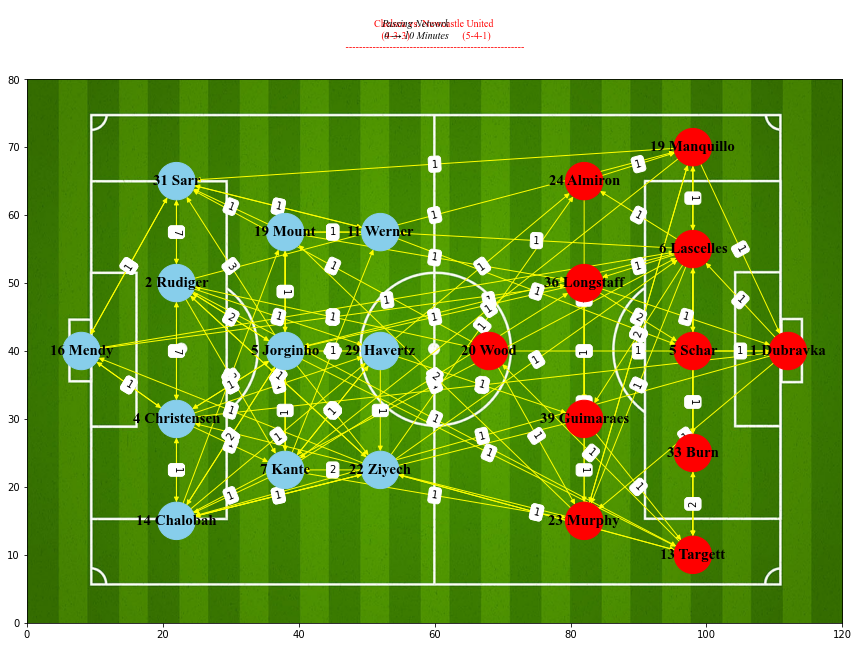


Total number of nodes:  22

Total number of edges:  105
Not to be confused with the total number of interceptions because these edges have weights.

The total number of passes that occured on field throughout this time interval = 142

View of Chelsea's Network



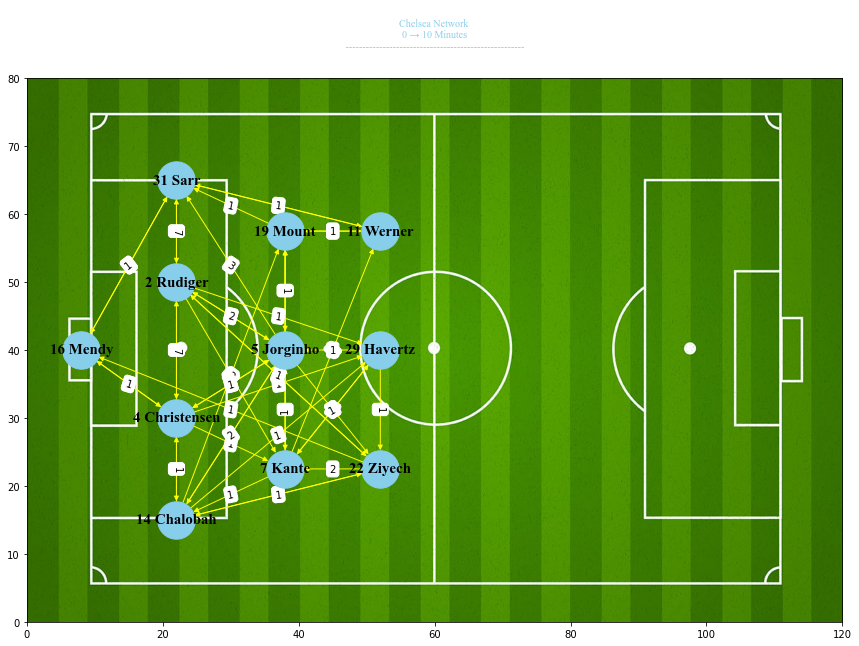


Total number of nodes:  11

Total number of edges:  46


Passing Network Density =  0.41818181818181815

Player:  5 Jorginho  | Degree Centrality:  12
Player:  4 Christensen  | Degree Centrality:  10
Player:  2 Rudiger  | Degree Centrality:  10
Player:  7 Kante  | Degree Centrality:  10
Player:  14 Chalobah  | Degree Centrality:  9
Player:  22 Ziyech  | Degree Centrality:  8
Player:  31 Sarr  | Degree Centrality:  8
Player:  19 Mount  | Degree Centrality:  8
Player:  29 Havertz  | Degree Centrality:  7
Player:  16 Mendy  | Degree Centrality:  5
Player:  11 Werner  | Degree Centrality:  5

Player:  5 Jorginho | Betweenness Centrality:  0.14842592592592593  | Degree:  12
Player:  2 Rudiger | Betweenness Centrality:  0.10777777777777779  | Degree:  10
Player:  7 Kante | Betweenness Centrality:  0.10592592592592592  | Degree:  10
Player:  4 Christensen | Betweenness Centrality:  0.10314814814814816  | Degree:  10
Player:  31 Sarr | Betweenness Centrality:  0.10175925925925924  | Degree:  

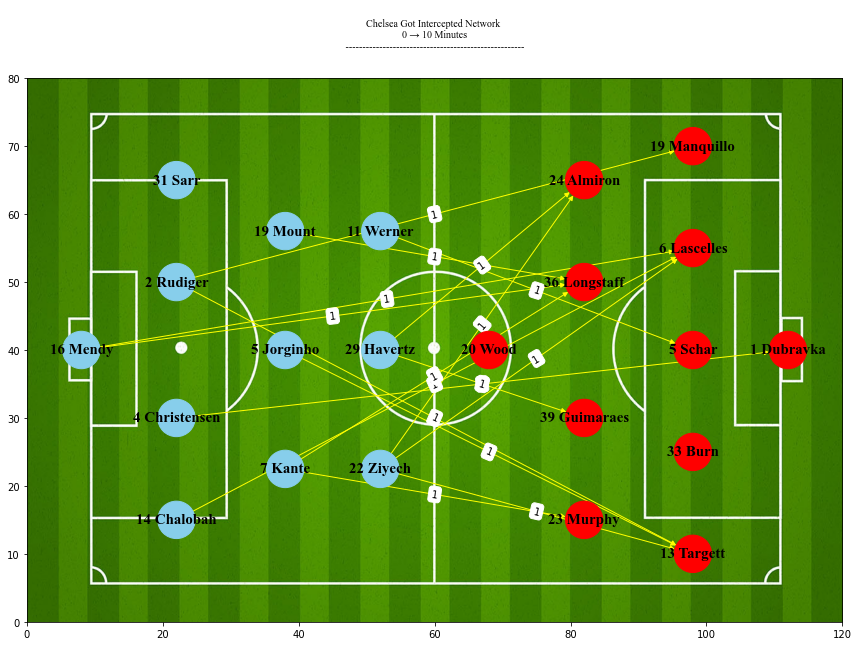


Total number of nodes:  22

Total number of edges:  16


Interception Network Density =  0.03463203463203463

The sum of passes of all Chelsea players only from other Chelsea players (aka successfull passes) = 75

The sum of indegrees of all Newcastle players only from Chelsea players (aka interceptions) = 16

Interception Ratio = 16 / 75 = 0.21333333333333335

View of Newcastle's Network



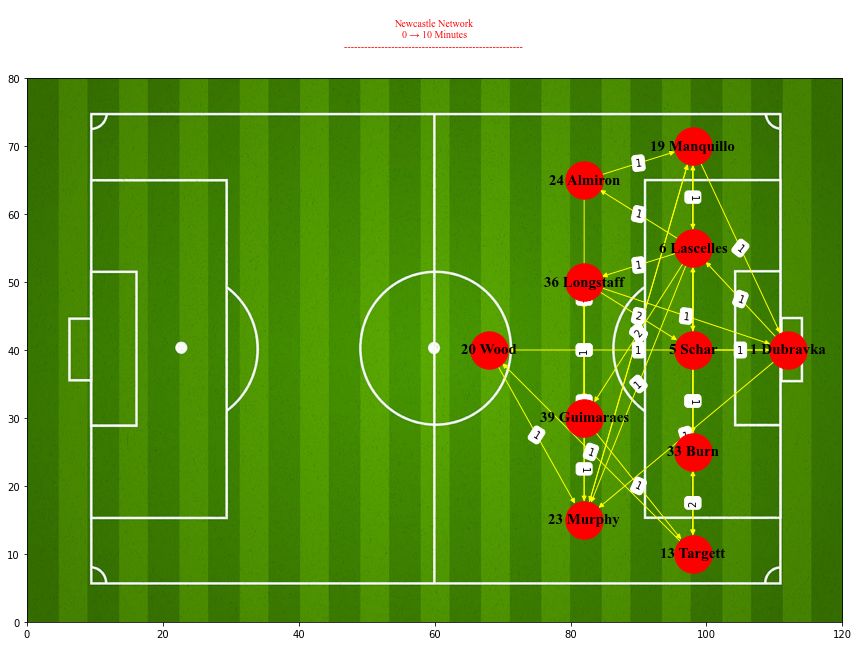


Total number of nodes:  11

Total number of edges:  31


Passing Network Density =  0.2818181818181818

Player:  6 Lascelles  | Degree Centrality:  9
Player:  19 Manquillo  | Degree Centrality:  7
Player:  23 Murphy  | Degree Centrality:  7
Player:  1 Dubravka  | Degree Centrality:  6
Player:  36 Longstaff  | Degree Centrality:  6
Player:  39 Guimaraes  | Degree Centrality:  6
Player:  5 Schar  | Degree Centrality:  5
Player:  33 Burn  | Degree Centrality:  5
Player:  13 Targett  | Degree Centrality:  5
Player:  20 Wood  | Degree Centrality:  3
Player:  24 Almiron  | Degree Centrality:  3

Player:  6 Lascelles | Betweenness Centrality:  0.30666666666666664  | Degree:  9
Player:  23 Murphy | Betweenness Centrality:  0.19518518518518518  | Degree:  7
Player:  19 Manquillo | Betweenness Centrality:  0.1896296296296296  | Degree:  7
Player:  36 Longstaff | Betweenness Centrality:  0.1648148148148148  | Degree:  6
Player:  1 Dubravka | Betweenness Centrality:  0.10629629629629629  | Degree

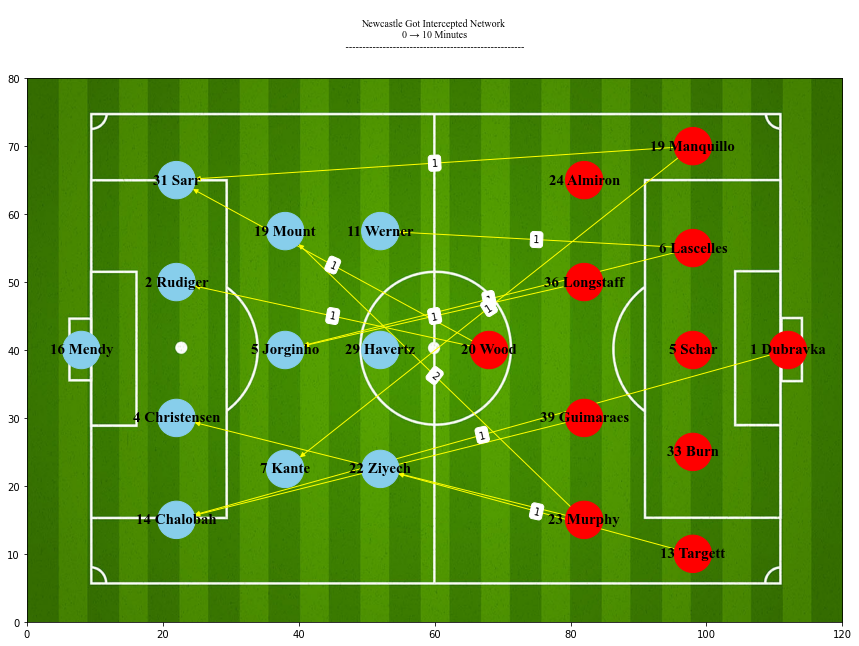


Total number of nodes:  22

Total number of edges:  12


Interception Network Density =  0.025974025974025976

The sum of passes of all Newcastle players only from other Newcastle players (aka successfull passes) = 38

The sum of indegrees of all Chelsea players only from Newcastles players (aka interceptions, Newcastle gave the ball to Chelsea) = 13

Interception Ratio = 13 / 38 = 0.34210526315789475



In [3]:
#Could simply add the arguments in the order of the parameters of the functions and make the code much shorter
#But we have chosen to use keywork-type arguments to clarify any ambiguity what those numbers might mean

Whole_Passing_Network (
                            Which_Half = "1st Half",
                            Time_Interval_String = "0 → 10 Minutes",  
                            Whole_Table_Excel_Index_Row_Start_IncludedinRange = 23,
                            Whole_Table_Excel_Index_Row_End_ExcludedfromRange = 45,
                            Whole_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                            Whole_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Chelsea_Performance_Visualization_and_Measures (
                                                    Which_Half = "1st Half",
                                                    Time_Interval_String = "0 → 10 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 23,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 34,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 15,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 23,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 34,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Newcastle_Performance_Visualization_and_Measures (    
                                                    Which_Half = "1st Half",
                                                    Time_Interval_String = "0 → 10 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 34,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 45,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 26,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 34,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 45,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 15)

## **Time Interval (in minutes): 10 → 20**

View of Overall Network



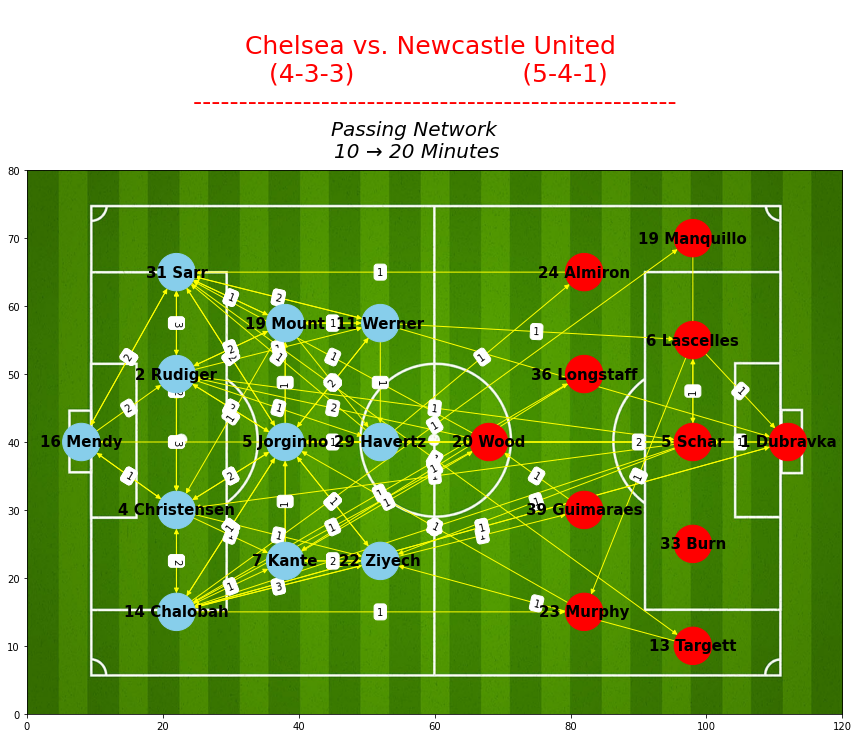


Total number of nodes:  22

Total number of edges:  82
Not to be confused with the total number of interceptions because these edges have weights.

The total number of passes that occured on field throughout this time interval = 120

View of Chelsea's Network



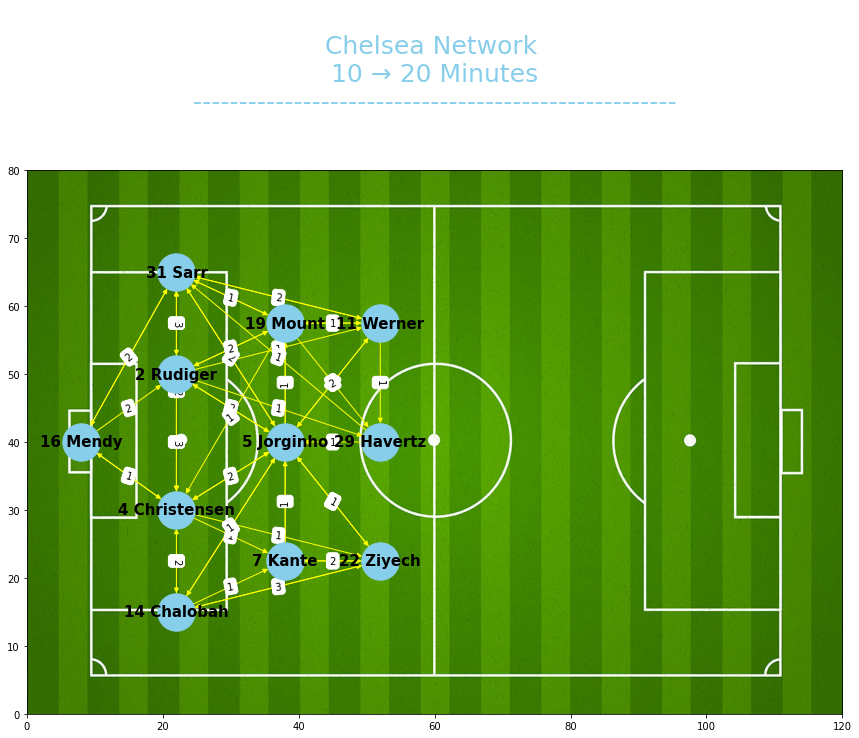


Total number of nodes:  11

Total number of edges:  50


Passing Network Density =  0.45454545454545453

Player:  5 Jorginho  | Degree Centrality:  15
Player:  4 Christensen  | Degree Centrality:  13
Player:  31 Sarr  | Degree Centrality:  13
Player:  2 Rudiger  | Degree Centrality:  11
Player:  19 Mount  | Degree Centrality:  10
Player:  11 Werner  | Degree Centrality:  8
Player:  14 Chalobah  | Degree Centrality:  7
Player:  22 Ziyech  | Degree Centrality:  7
Player:  7 Kante  | Degree Centrality:  6
Player:  16 Mendy  | Degree Centrality:  5
Player:  29 Havertz  | Degree Centrality:  5

Player:  5 Jorginho | Betweenness Centrality:  0.2457407407407407  | Degree:  15
Player:  4 Christensen | Betweenness Centrality:  0.18703703703703706  | Degree:  13
Player:  31 Sarr | Betweenness Centrality:  0.10629629629629629  | Degree:  13
Player:  19 Mount | Betweenness Centrality:  0.06592592592592593  | Degree:  10
Player:  2 Rudiger | Betweenness Centrality:  0.060370370370370366  | Degree:

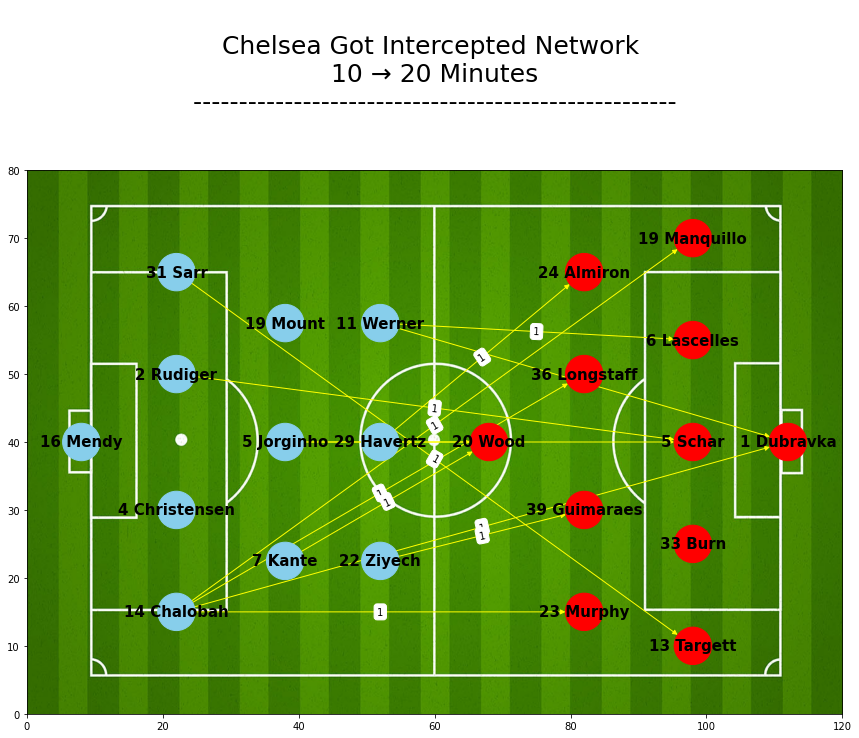


Total number of nodes:  22

Total number of edges:  13


Interception Network Density =  0.02813852813852814

The sum of passes of all Chelsea players only from other Chelsea players (aka successfull passes) = 86

The sum of indegrees of all Newcastle players only from Chelsea players (aka interceptions) = 13

Interception Ratio = 13 / 86 = 0.1511627906976744

View of Newcastle's Network



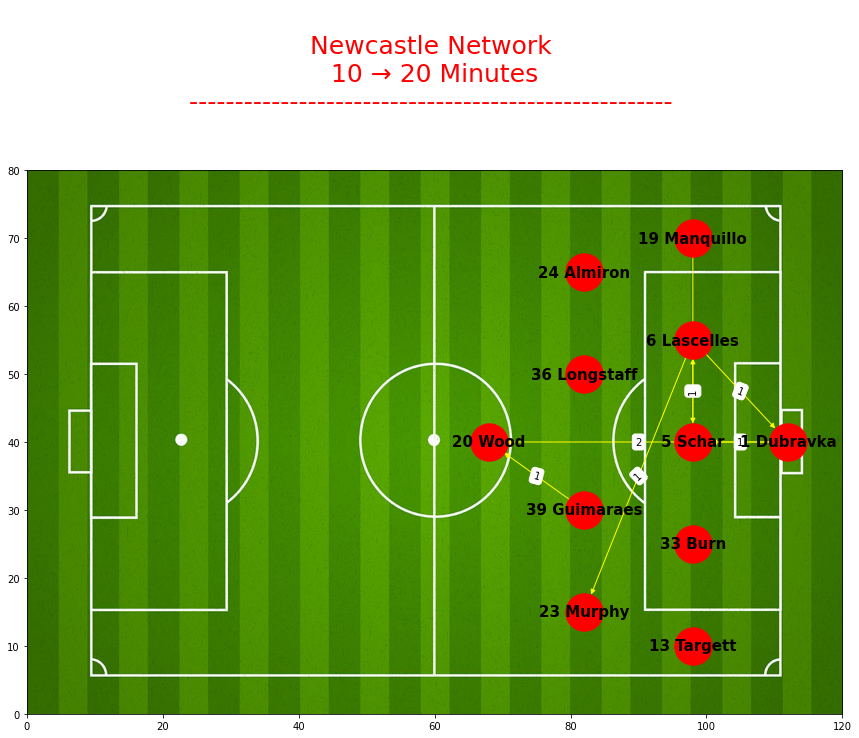


Total number of nodes:  11

Total number of edges:  7


Passing Network Density =  0.06363636363636363

Player:  1 Dubravka  | Degree Centrality:  3
Player:  5 Schar  | Degree Centrality:  3
Player:  6 Lascelles  | Degree Centrality:  3
Player:  20 Wood  | Degree Centrality:  2
Player:  19 Manquillo  | Degree Centrality:  1
Player:  39 Guimaraes  | Degree Centrality:  1
Player:  23 Murphy  | Degree Centrality:  1
Player:  33 Burn  | Degree Centrality:  0
Player:  36 Longstaff  | Degree Centrality:  0
Player:  13 Targett  | Degree Centrality:  0
Player:  24 Almiron  | Degree Centrality:  0

Player:  6 Lascelles | Betweenness Centrality:  0.07777777777777778  | Degree:  3
Player:  5 Schar | Betweenness Centrality:  0.06666666666666667  | Degree:  3
Player:  1 Dubravka | Betweenness Centrality:  0.044444444444444446  | Degree:  3
Player:  33 Burn | Betweenness Centrality:  0.0  | Degree:  0
Player:  19 Manquillo | Betweenness Centrality:  0.0  | Degree:  1
Player:  36 Longstaff | Between

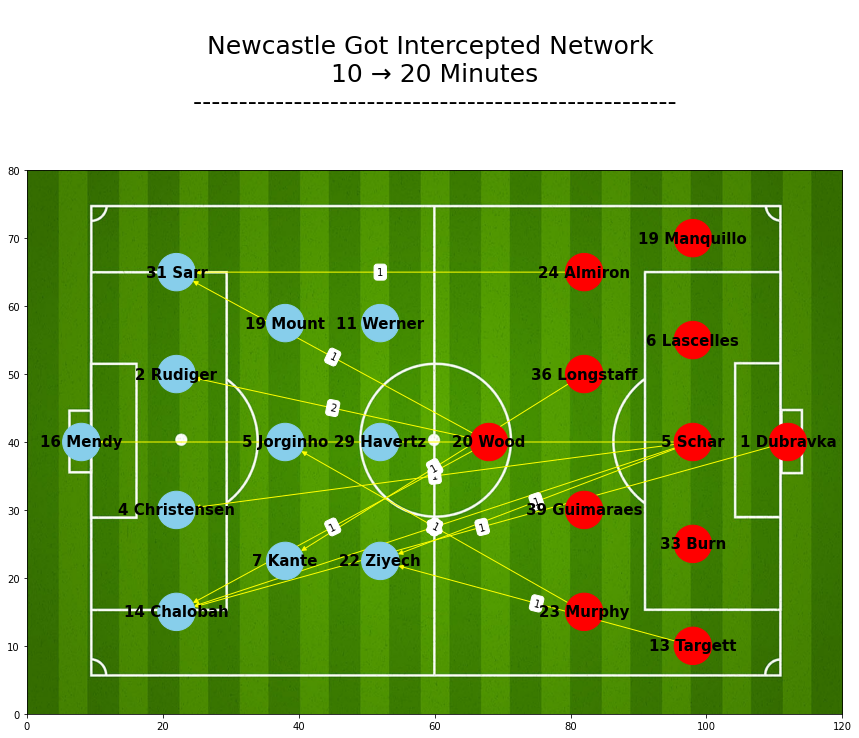


Total number of nodes:  22

Total number of edges:  12


Interception Network Density =  0.025974025974025976

The sum of passes of all Newcastle players only from other Newcastle players (aka successfull passes) = 8

The sum of indegrees of all Chelsea players only from Newcastles players (aka interceptions, Newcastle gave the ball to Chelsea) = 13

Interception Ratio = 13 / 8 = 1.625



In [5]:
Whole_Passing_Network (
                            Which_Half = "1st Half",
                            Time_Interval_String = "10 → 20 Minutes",  
                            Whole_Table_Excel_Index_Row_Start_IncludedinRange = 56,
                            Whole_Table_Excel_Index_Row_End_ExcludedfromRange = 78,
                            Whole_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                            Whole_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Chelsea_Performance_Visualization_and_Measures (
                                                    Which_Half = "1st Half",
                                                    Time_Interval_String = "10 → 20 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 56,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 67,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 15,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 56,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 67,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Newcastle_Performance_Visualization_and_Measures (    
                                                    Which_Half = "1st Half",
                                                    Time_Interval_String = "10 → 20 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 67,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 78,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 26,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 67,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 78,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 15)

## **Time Interval (in minutes): 20 → 30**

View of Overall Network



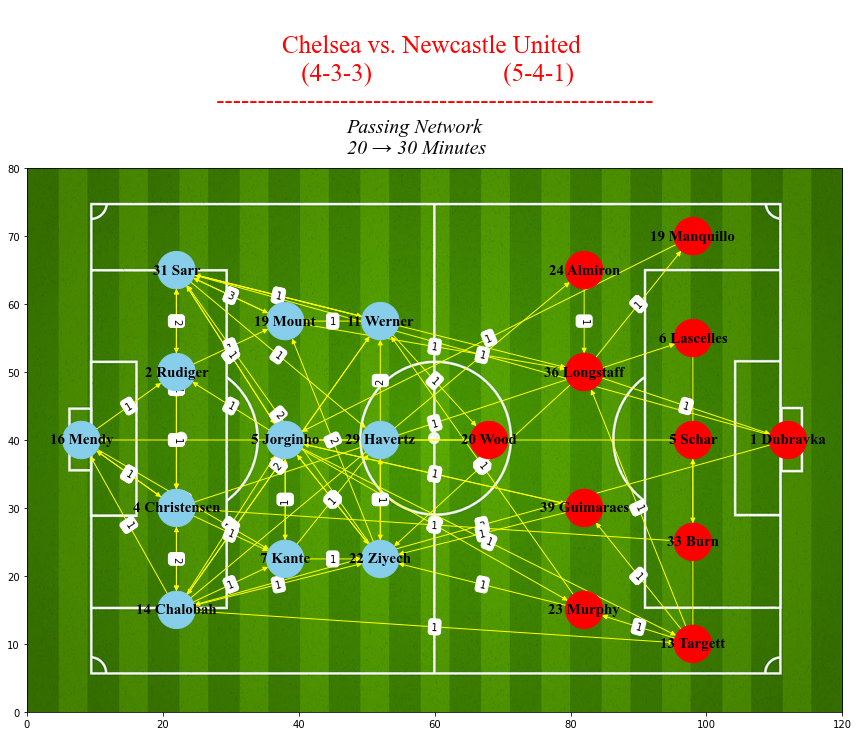


Total number of nodes:  22

Total number of edges:  69
Not to be confused with the total number of interceptions because these edges have weights.

The total number of passes that occured on field throughout this time interval = 87

View of Chelsea's Network



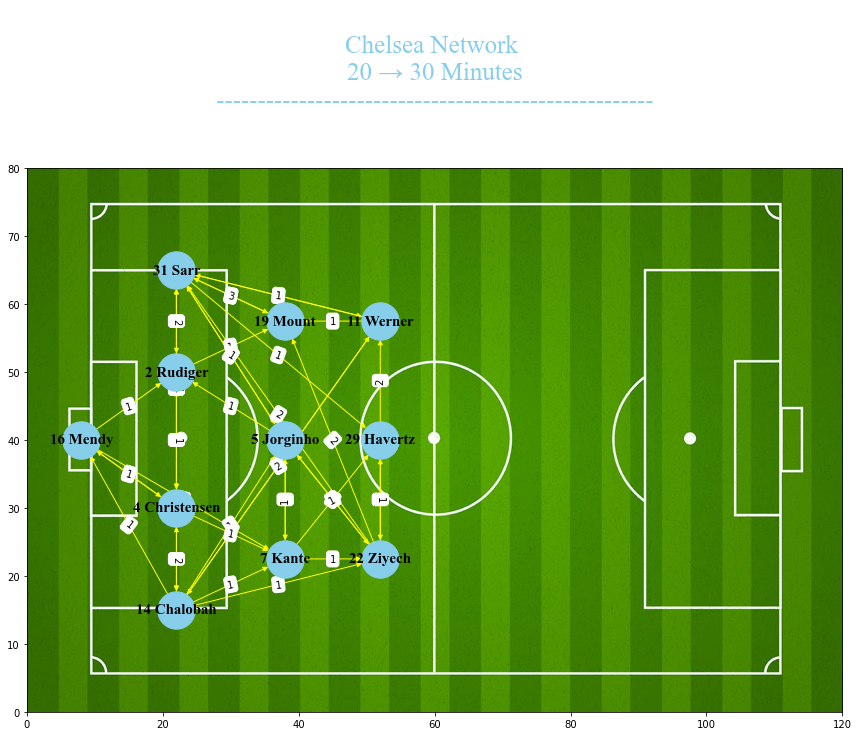


Total number of nodes:  11

Total number of edges:  41


Passing Network Density =  0.37272727272727274

Player:  31 Sarr  | Degree Centrality:  13
Player:  14 Chalobah  | Degree Centrality:  9
Player:  4 Christensen  | Degree Centrality:  9
Player:  22 Ziyech  | Degree Centrality:  8
Player:  5 Jorginho  | Degree Centrality:  8
Player:  2 Rudiger  | Degree Centrality:  7
Player:  7 Kante  | Degree Centrality:  7
Player:  11 Werner  | Degree Centrality:  6
Player:  16 Mendy  | Degree Centrality:  5
Player:  19 Mount  | Degree Centrality:  5
Player:  29 Havertz  | Degree Centrality:  5

Player:  31 Sarr | Betweenness Centrality:  0.3288888888888889  | Degree:  13
Player:  14 Chalobah | Betweenness Centrality:  0.12759259259259262  | Degree:  9
Player:  4 Christensen | Betweenness Centrality:  0.09796296296296296  | Degree:  9
Player:  22 Ziyech | Betweenness Centrality:  0.08796296296296297  | Degree:  8
Player:  5 Jorginho | Betweenness Centrality:  0.08277777777777778  | Degree:  8
P

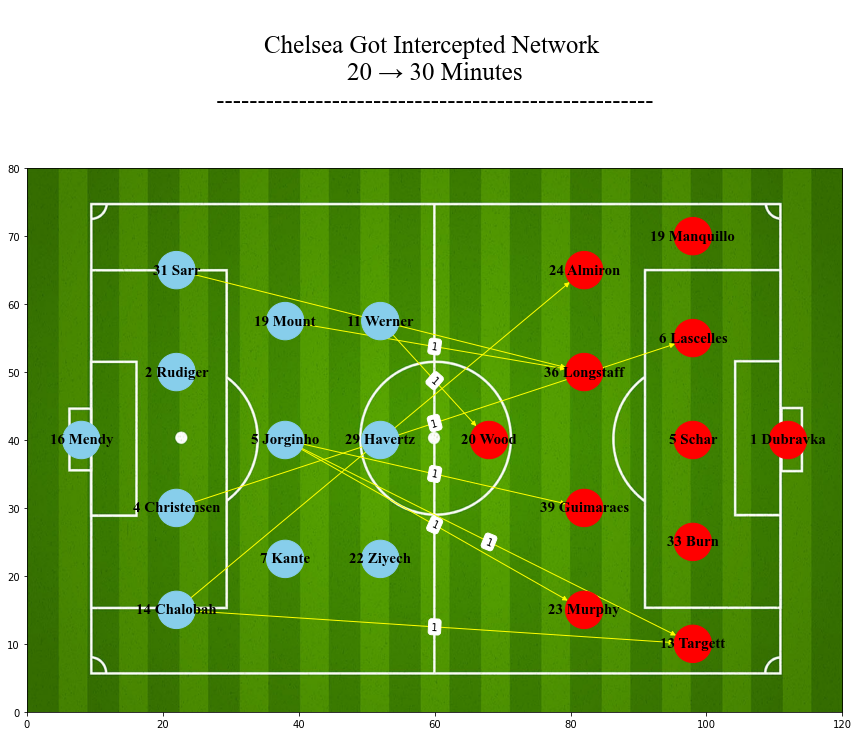


Total number of nodes:  22

Total number of edges:  9


Passing Network Density =  0.01948051948051948

The sum of passes of all Chelsea players only from other Chelsea players (aka successfull passes) = 58

The sum of indegrees of all Newcastle players only from Chelsea players (aka interceptions) = 9

Interception Ratio = 9 / 58 = 0.15517241379310345

View of Newcastle's Network



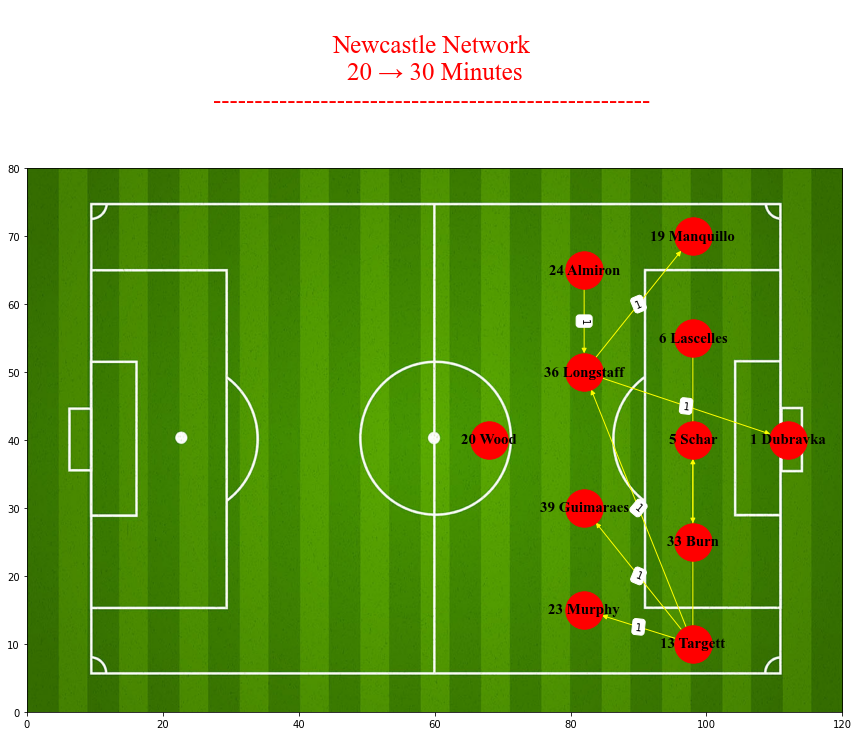


Total number of nodes:  11

Total number of edges:  8


Passing Network Density =  0.07272727272727272

Player:  36 Longstaff  | Degree Centrality:  4
Player:  13 Targett  | Degree Centrality:  4
Player:  1 Dubravka  | Degree Centrality:  1
Player:  5 Schar  | Degree Centrality:  1
Player:  6 Lascelles  | Degree Centrality:  1
Player:  33 Burn  | Degree Centrality:  1
Player:  19 Manquillo  | Degree Centrality:  1
Player:  39 Guimaraes  | Degree Centrality:  1
Player:  23 Murphy  | Degree Centrality:  1
Player:  24 Almiron  | Degree Centrality:  1
Player:  20 Wood  | Degree Centrality:  0

Player:  36 Longstaff | Betweenness Centrality:  0.044444444444444446  | Degree:  4
Player:  1 Dubravka | Betweenness Centrality:  0.0  | Degree:  1
Player:  5 Schar | Betweenness Centrality:  0.0  | Degree:  1
Player:  6 Lascelles | Betweenness Centrality:  0.0  | Degree:  1
Player:  33 Burn | Betweenness Centrality:  0.0  | Degree:  1
Player:  19 Manquillo | Betweenness Centrality:  0.0  | Degree:

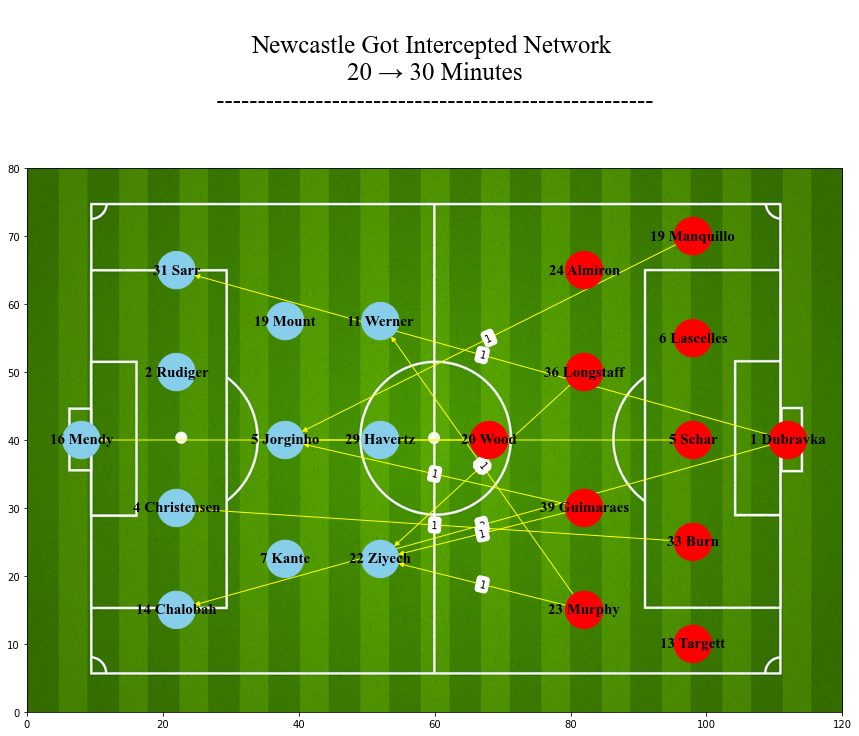


Total number of nodes:  22

Total number of edges:  11


Passing Network Density =  0.023809523809523808

The sum of passes of all Newcastle players only from other Newcastle players (aka successfull passes) = 8

The sum of indegrees of all Chelsea players only from Newcastles players (aka interceptions, Newcastle gave the ball to Chelsea) = 12

Interception Ratio = 12 / 8 = 1.5



In [19]:
Whole_Passing_Network (
                            Which_Half = "1st Half",
                            Time_Interval_String = "20 → 30 Minutes",  
                            Whole_Table_Excel_Index_Row_Start_IncludedinRange = 89,
                            Whole_Table_Excel_Index_Row_End_ExcludedfromRange = 111,
                            Whole_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                            Whole_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Chelsea_Performance_Visualization_and_Measures (
                                                    Which_Half = "1st Half",
                                                    Time_Interval_String = "20 → 30 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 89,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 100,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 15,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 89,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 100,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Newcastle_Performance_Visualization_and_Measures (    
                                                    Which_Half = "1st Half",
                                                    Time_Interval_String = "20 → 30 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 100,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 111,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 26,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 100,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 111,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 15)

## **Time Interval (in minutes): 30 → 40**

View of Overall Network



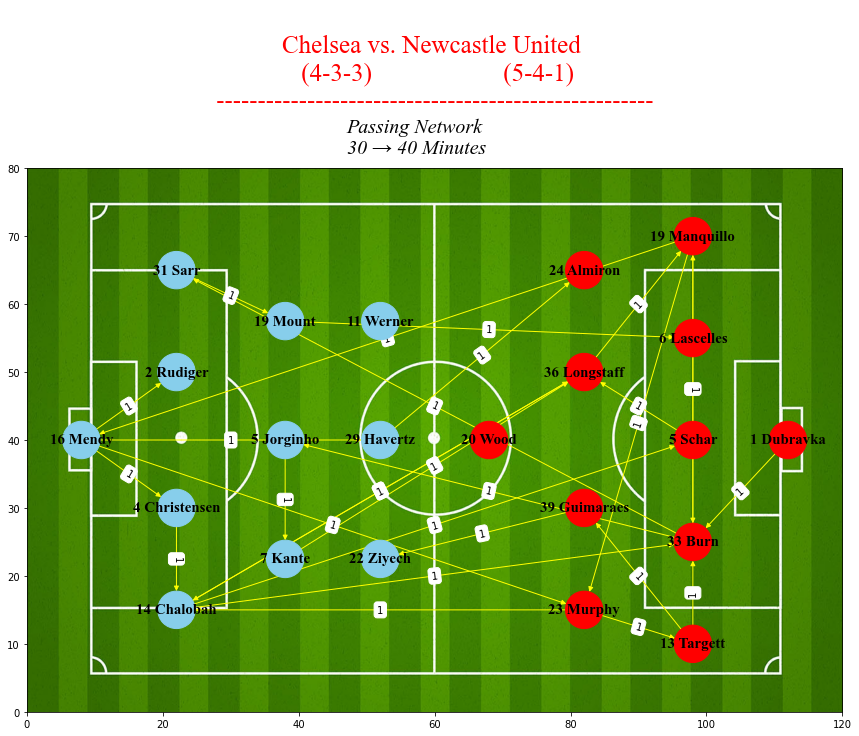


Total number of nodes:  22

Total number of edges:  28
Not to be confused with the total number of interceptions because these edges have weights.

The total number of passes that occured on field throughout this time interval = 28

View of Chelsea's Network



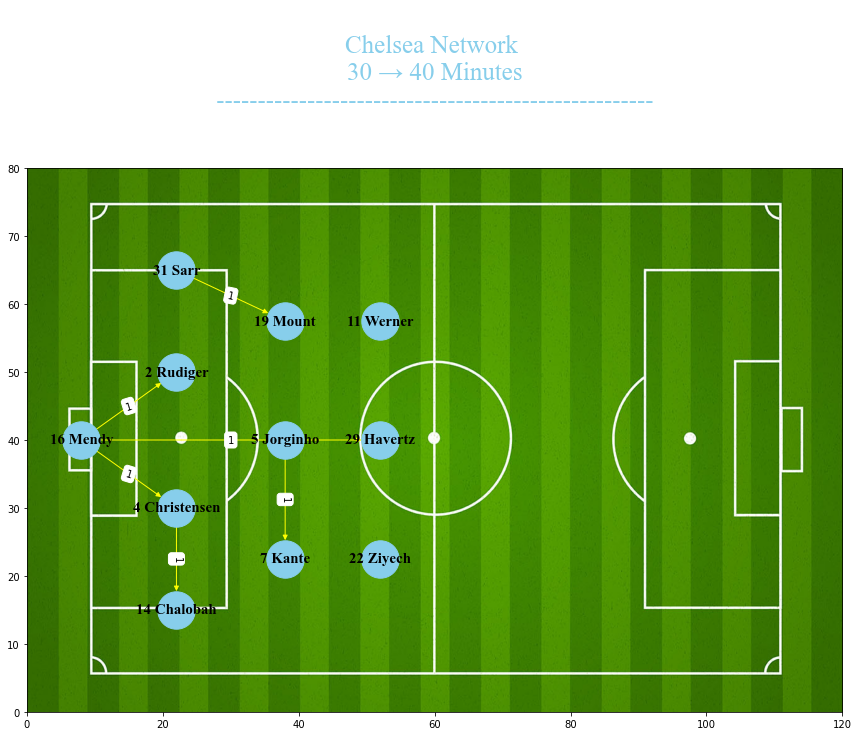


Total number of nodes:  11

Total number of edges:  6


Passing Network Density =  0.05454545454545454

Player:  16 Mendy  | Degree Centrality:  3
Player:  4 Christensen  | Degree Centrality:  2
Player:  14 Chalobah  | Degree Centrality:  1
Player:  2 Rudiger  | Degree Centrality:  1
Player:  5 Jorginho  | Degree Centrality:  1
Player:  7 Kante  | Degree Centrality:  1
Player:  31 Sarr  | Degree Centrality:  1
Player:  19 Mount  | Degree Centrality:  1
Player:  29 Havertz  | Degree Centrality:  1
Player:  22 Ziyech  | Degree Centrality:  0
Player:  11 Werner  | Degree Centrality:  0

Player:  4 Christensen | Betweenness Centrality:  0.011111111111111112  | Degree:  2
Player:  16 Mendy | Betweenness Centrality:  0.0  | Degree:  3
Player:  14 Chalobah | Betweenness Centrality:  0.0  | Degree:  1
Player:  2 Rudiger | Betweenness Centrality:  0.0  | Degree:  1
Player:  22 Ziyech | Betweenness Centrality:  0.0  | Degree:  0
Player:  5 Jorginho | Betweenness Centrality:  0.0  | Degree:  1
P

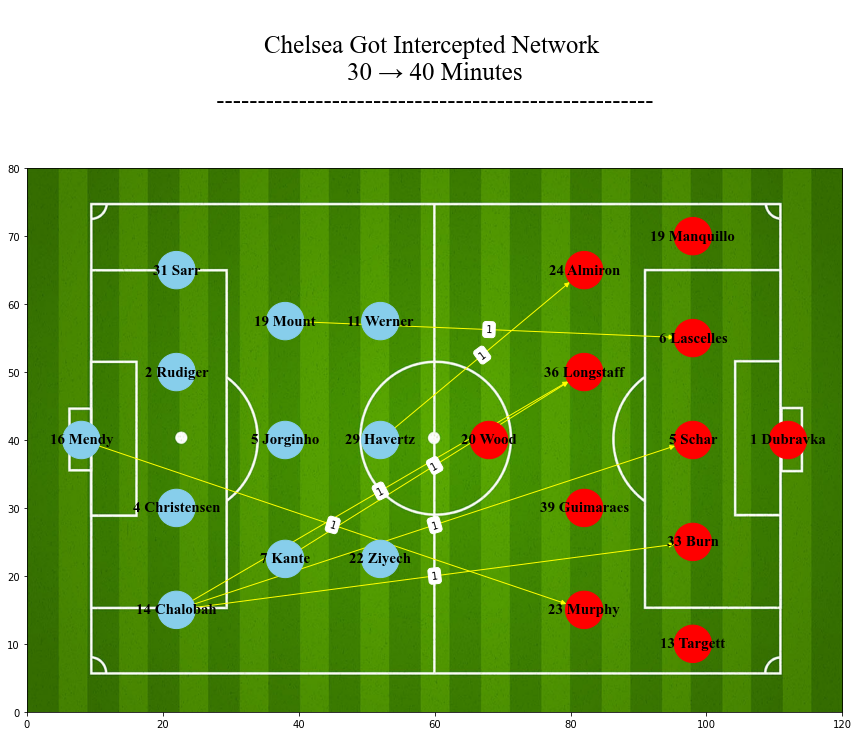


Total number of nodes:  22

Total number of edges:  7


Passing Network Density =  0.015151515151515152

The sum of passes of all Chelsea players only from other Chelsea players (aka successfull passes) = 6

The sum of indegrees of all Newcastle players only from Chelsea players (aka interceptions) = 7

Interception Ratio = 7 / 6 = 1.1666666666666667

View of Newcastle's Network



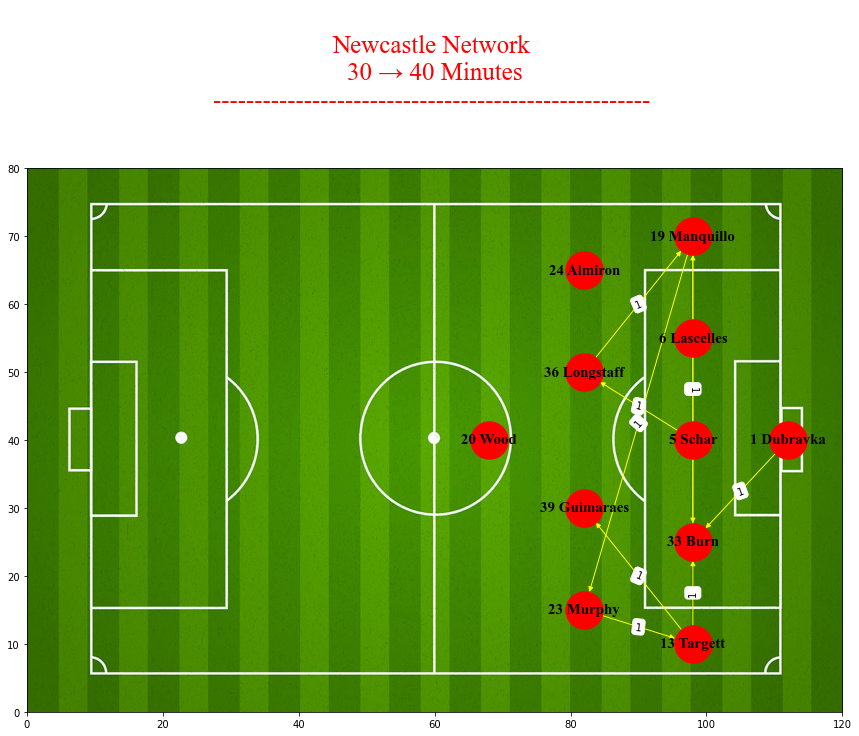


Total number of nodes:  11

Total number of edges:  9


Passing Network Density =  0.08181818181818182

Player:  33 Burn  | Degree Centrality:  4
Player:  19 Manquillo  | Degree Centrality:  4
Player:  13 Targett  | Degree Centrality:  3
Player:  36 Longstaff  | Degree Centrality:  2
Player:  23 Murphy  | Degree Centrality:  2
Player:  1 Dubravka  | Degree Centrality:  1
Player:  5 Schar  | Degree Centrality:  1
Player:  39 Guimaraes  | Degree Centrality:  1
Player:  6 Lascelles  | Degree Centrality:  0
Player:  20 Wood  | Degree Centrality:  0
Player:  24 Almiron  | Degree Centrality:  0

Player:  19 Manquillo | Betweenness Centrality:  0.16666666666666669  | Degree:  4
Player:  23 Murphy | Betweenness Centrality:  0.11111111111111112  | Degree:  2
Player:  13 Targett | Betweenness Centrality:  0.08888888888888889  | Degree:  3
Player:  33 Burn | Betweenness Centrality:  0.07777777777777778  | Degree:  4
Player:  36 Longstaff | Betweenness Centrality:  0.05555555555555556  | Degree: 

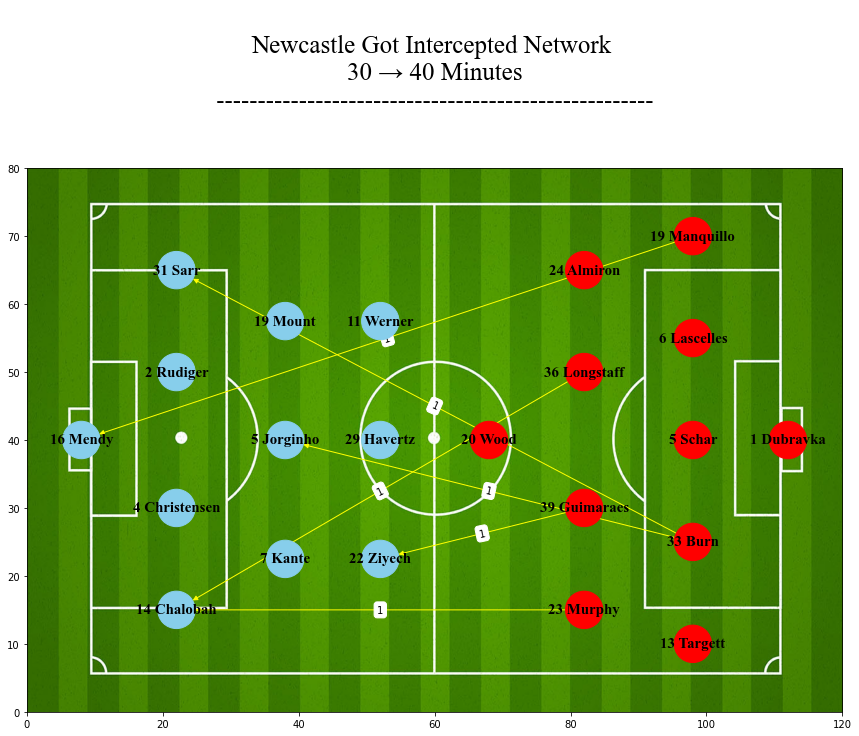


Total number of nodes:  22

Total number of edges:  6


Passing Network Density =  0.012987012987012988

The sum of passes of all Newcastle players only from other Newcastle players (aka successfull passes) = 9

The sum of indegrees of all Chelsea players only from Newcastles players (aka interceptions, Newcastle gave the ball to Chelsea) = 6

Interception Ratio = 6 / 9 = 0.6666666666666666



In [20]:
Whole_Passing_Network (
                            Which_Half = "1st Half",
                            Time_Interval_String = "30 → 40 Minutes",  
                            Whole_Table_Excel_Index_Row_Start_IncludedinRange = 122,
                            Whole_Table_Excel_Index_Row_End_ExcludedfromRange = 144,
                            Whole_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                            Whole_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Chelsea_Performance_Visualization_and_Measures (
                                                    Which_Half = "1st Half",
                                                    Time_Interval_String = "30 → 40 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 122,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 133,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 15,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 122,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 133,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Newcastle_Performance_Visualization_and_Measures (    
                                                    Which_Half = "1st Half",
                                                    Time_Interval_String = "30 → 40 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 133,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 144,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 26,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 133,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 144,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 15)

## **Time Interval (in minutes): 40 → 45**

View of Overall Network



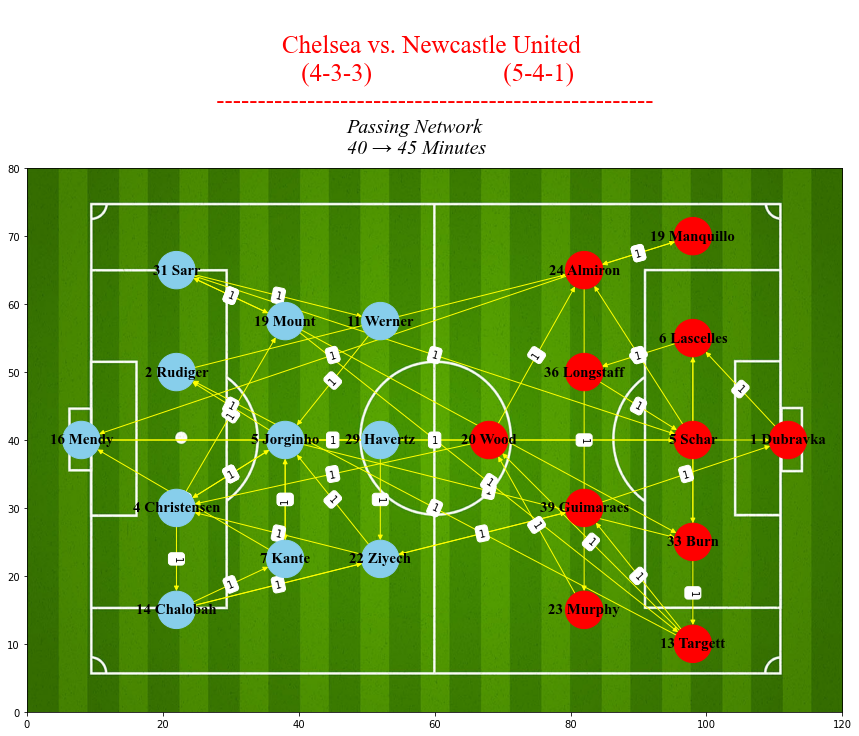


Total number of nodes:  22

Total number of edges:  45
Not to be confused with the total number of interceptions because these edges have weights.

The total number of passes that occured on field throughout this time interval = 46

View of Chelsea's Network



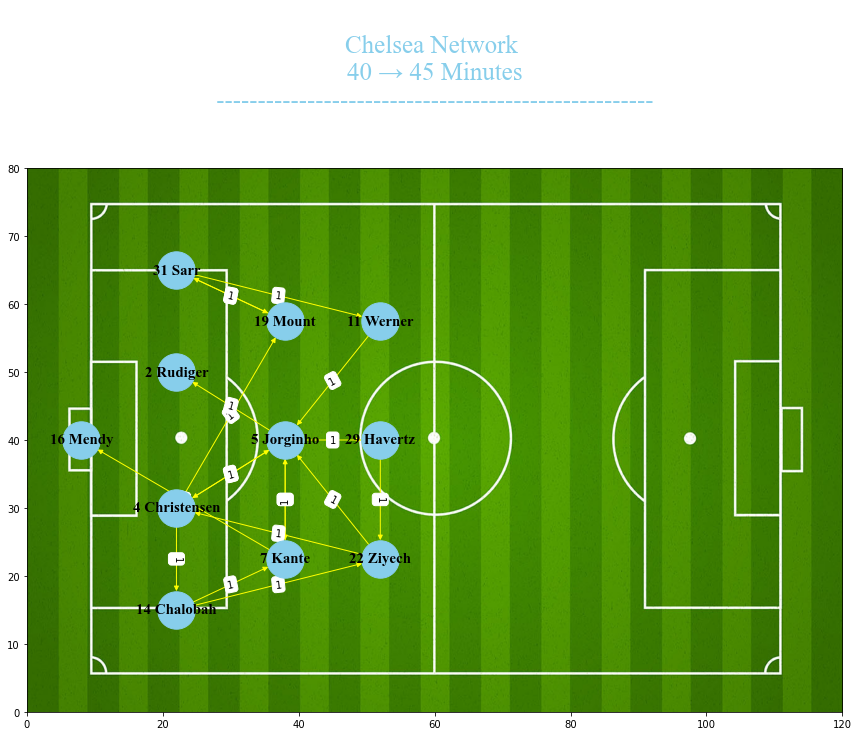


Total number of nodes:  11

Total number of edges:  18


Passing Network Density =  0.16363636363636364

Player:  5 Jorginho  | Degree Centrality:  8
Player:  4 Christensen  | Degree Centrality:  5
Player:  22 Ziyech  | Degree Centrality:  4
Player:  7 Kante  | Degree Centrality:  4
Player:  14 Chalobah  | Degree Centrality:  3
Player:  31 Sarr  | Degree Centrality:  3
Player:  19 Mount  | Degree Centrality:  3
Player:  29 Havertz  | Degree Centrality:  2
Player:  11 Werner  | Degree Centrality:  2
Player:  16 Mendy  | Degree Centrality:  1
Player:  2 Rudiger  | Degree Centrality:  1

Player:  5 Jorginho | Betweenness Centrality:  0.4777777777777778  | Degree:  8
Player:  4 Christensen | Betweenness Centrality:  0.26666666666666666  | Degree:  5
Player:  11 Werner | Betweenness Centrality:  0.17777777777777778  | Degree:  2
Player:  31 Sarr | Betweenness Centrality:  0.16666666666666669  | Degree:  3
Player:  22 Ziyech | Betweenness Centrality:  0.16111111111111112  | Degree:  4
Playe

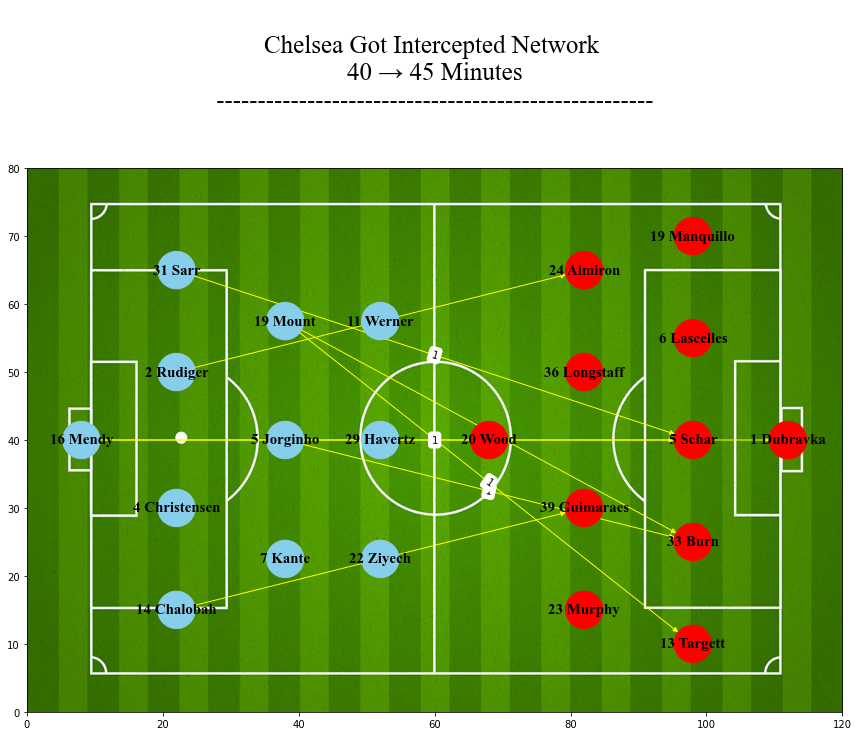


Total number of nodes:  22

Total number of edges:  8


Passing Network Density =  0.017316017316017316

The sum of passes of all Chelsea players only from other Chelsea players (aka successfull passes) = 18

The sum of indegrees of all Newcastle players only from Chelsea players (aka interceptions) = 9

Interception Ratio = 9 / 18 = 0.5

View of Newcastle's Network



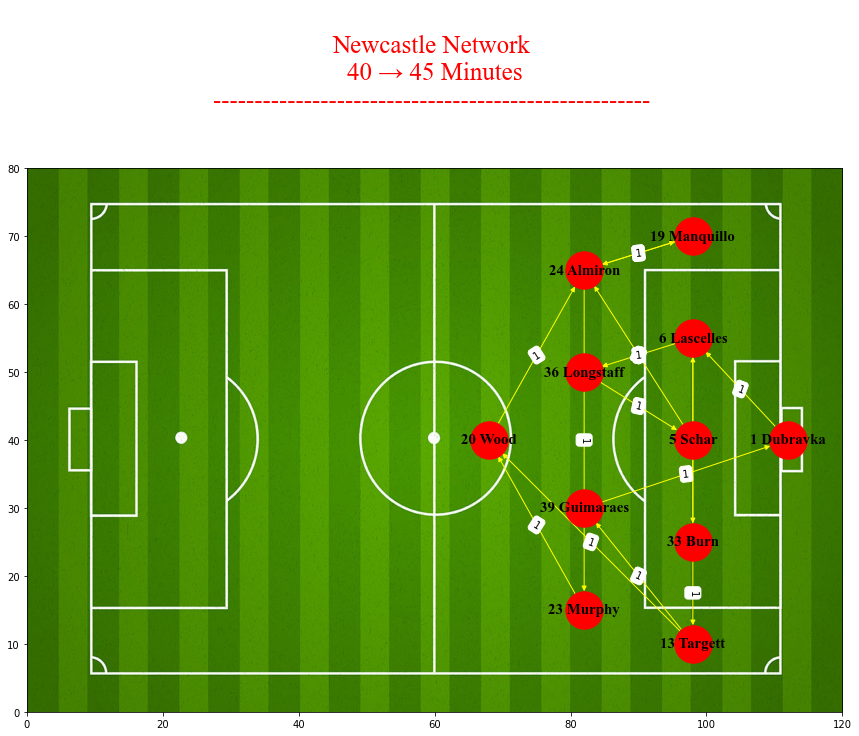


Total number of nodes:  11

Total number of edges:  15


Passing Network Density =  0.13636363636363635

Player:  24 Almiron  | Degree Centrality:  5
Player:  6 Lascelles  | Degree Centrality:  4
Player:  33 Burn  | Degree Centrality:  3
Player:  13 Targett  | Degree Centrality:  3
Player:  20 Wood  | Degree Centrality:  3
Player:  1 Dubravka  | Degree Centrality:  2
Player:  5 Schar  | Degree Centrality:  2
Player:  19 Manquillo  | Degree Centrality:  2
Player:  36 Longstaff  | Degree Centrality:  2
Player:  39 Guimaraes  | Degree Centrality:  2
Player:  23 Murphy  | Degree Centrality:  2

Player:  6 Lascelles | Betweenness Centrality:  0.24444444444444446  | Degree:  4
Player:  24 Almiron | Betweenness Centrality:  0.23333333333333334  | Degree:  5
Player:  36 Longstaff | Betweenness Centrality:  0.15555555555555556  | Degree:  2
Player:  1 Dubravka | Betweenness Centrality:  0.14444444444444446  | Degree:  2
Player:  5 Schar | Betweenness Centrality:  0.14444444444444446  | Degree:

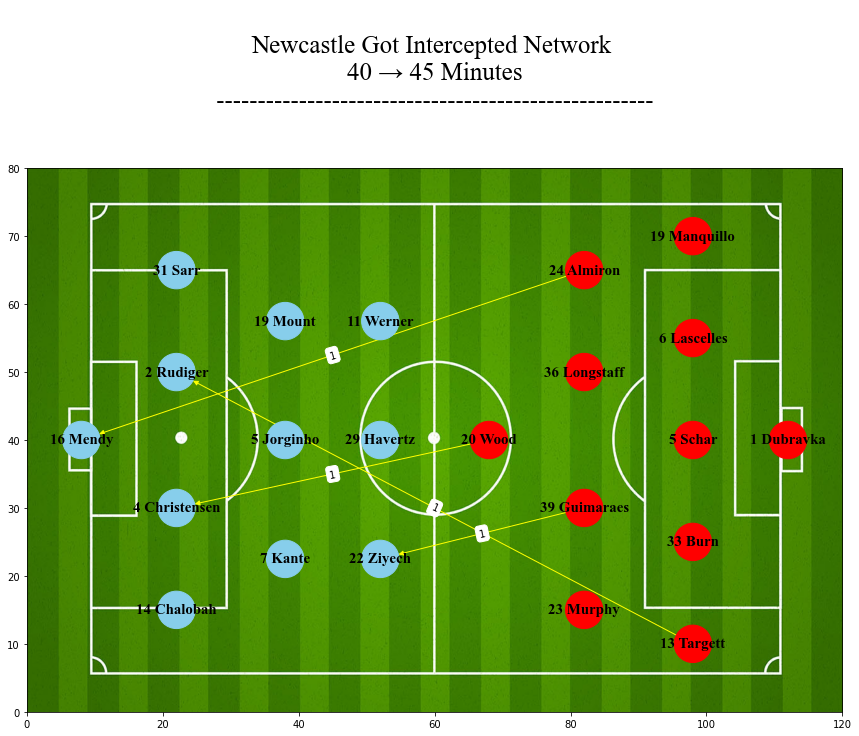


Total number of nodes:  22

Total number of edges:  4


Passing Network Density =  0.008658008658008658

The sum of passes of all Newcastle players only from other Newcastle players (aka successfull passes) = 15

The sum of indegrees of all Chelsea players only from Newcastles players (aka interceptions, Newcastle gave the ball to Chelsea) = 4

Interception Ratio = 4 / 15 = 0.26666666666666666



In [21]:
Whole_Passing_Network (
                            Which_Half = "1st Half",
                            Time_Interval_String = "40 → 45 Minutes",  
                            Whole_Table_Excel_Index_Row_Start_IncludedinRange = 155,
                            Whole_Table_Excel_Index_Row_End_ExcludedfromRange = 177,
                            Whole_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                            Whole_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Chelsea_Performance_Visualization_and_Measures (
                                                    Which_Half = "1st Half",
                                                    Time_Interval_String = "40 → 45 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 155,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 166,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 15,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 155,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 166,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Newcastle_Performance_Visualization_and_Measures (    
                                                    Which_Half = "1st Half",
                                                    Time_Interval_String = "40 → 45 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 166,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 177,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 26,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 166,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 177,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 15)

## **Time Interval (in minutes): 45 → 50** - (2nd Half)

View of Overall Network



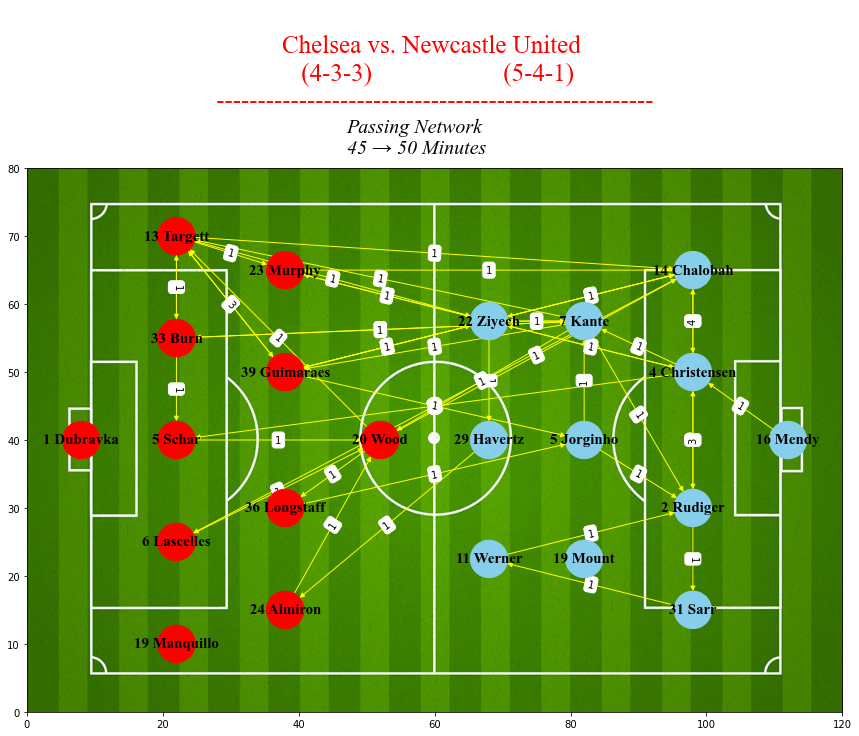


Total number of nodes:  22

Total number of edges:  48
Not to be confused with the total number of interceptions because these edges have weights.

The total number of passes that occured on field throughout this time interval = 60

View of Chelsea's Network



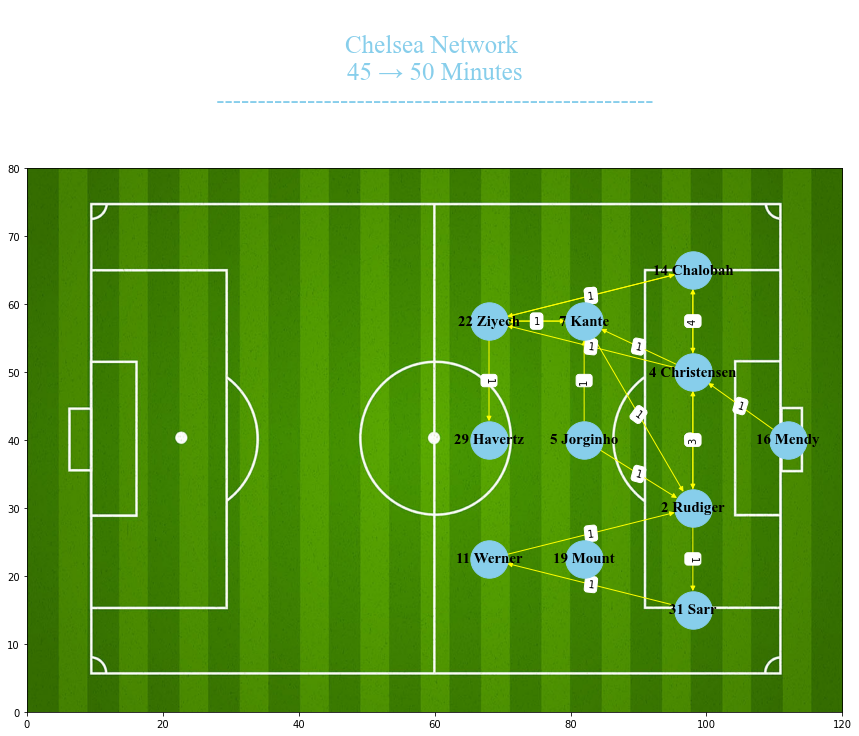


Total number of nodes:  11

Total number of edges:  18


Passing Network Density =  0.16363636363636364

Player:  4 Christensen  | Degree Centrality:  7
Player:  2 Rudiger  | Degree Centrality:  6
Player:  22 Ziyech  | Degree Centrality:  6
Player:  7 Kante  | Degree Centrality:  5
Player:  14 Chalobah  | Degree Centrality:  4
Player:  5 Jorginho  | Degree Centrality:  2
Player:  31 Sarr  | Degree Centrality:  2
Player:  11 Werner  | Degree Centrality:  2
Player:  16 Mendy  | Degree Centrality:  1
Player:  29 Havertz  | Degree Centrality:  1
Player:  19 Mount  | Degree Centrality:  0

Player:  2 Rudiger | Betweenness Centrality:  0.2833333333333333  | Degree:  6
Player:  4 Christensen | Betweenness Centrality:  0.2555555555555556  | Degree:  7
Player:  22 Ziyech | Betweenness Centrality:  0.11111111111111112  | Degree:  6
Player:  31 Sarr | Betweenness Centrality:  0.07777777777777778  | Degree:  2
Player:  11 Werner | Betweenness Centrality:  0.06666666666666667  | Degree:  2
Player:

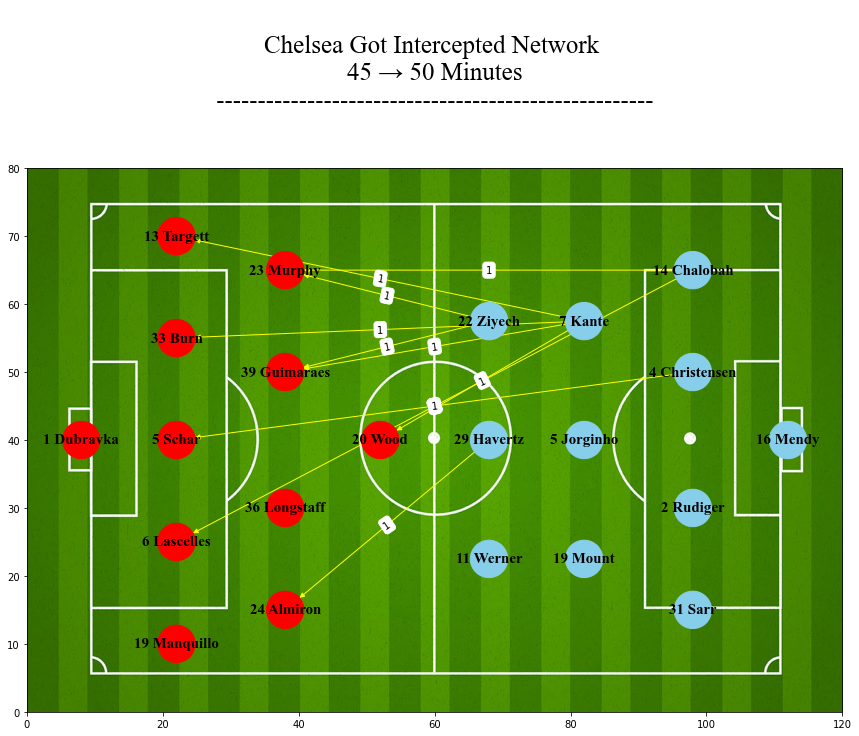


Total number of nodes:  22

Total number of edges:  10


Interception Network Density =  0.021645021645021644

The sum of passes of all Chelsea players only from other Chelsea players (aka successfull passes) = 28

The sum of indegrees of all Newcastle players only from Chelsea players (aka interceptions) = 10

Interception Ratio = 10 / 28 = 0.35714285714285715

View of Newcastle's Network



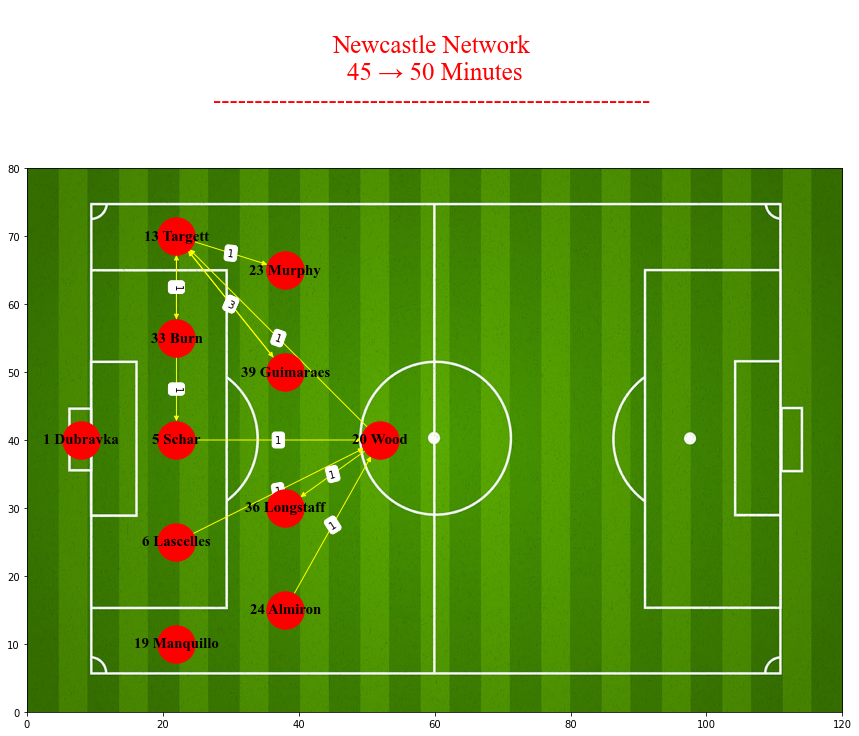


Total number of nodes:  11

Total number of edges:  11


Passing Network Density =  0.1

Player:  13 Targett  | Degree Centrality:  6
Player:  20 Wood  | Degree Centrality:  5
Player:  33 Burn  | Degree Centrality:  3
Player:  5 Schar  | Degree Centrality:  2
Player:  39 Guimaraes  | Degree Centrality:  2
Player:  6 Lascelles  | Degree Centrality:  1
Player:  36 Longstaff  | Degree Centrality:  1
Player:  23 Murphy  | Degree Centrality:  1
Player:  24 Almiron  | Degree Centrality:  1
Player:  1 Dubravka  | Degree Centrality:  0
Player:  19 Manquillo  | Degree Centrality:  0

Player:  13 Targett | Betweenness Centrality:  0.24444444444444446  | Degree:  6
Player:  20 Wood | Betweenness Centrality:  0.22222222222222224  | Degree:  5
Player:  33 Burn | Betweenness Centrality:  0.1  | Degree:  3
Player:  5 Schar | Betweenness Centrality:  0.06666666666666667  | Degree:  2
Player:  1 Dubravka | Betweenness Centrality:  0.0  | Degree:  0
Player:  6 Lascelles | Betweenness Centrality:  0.0  

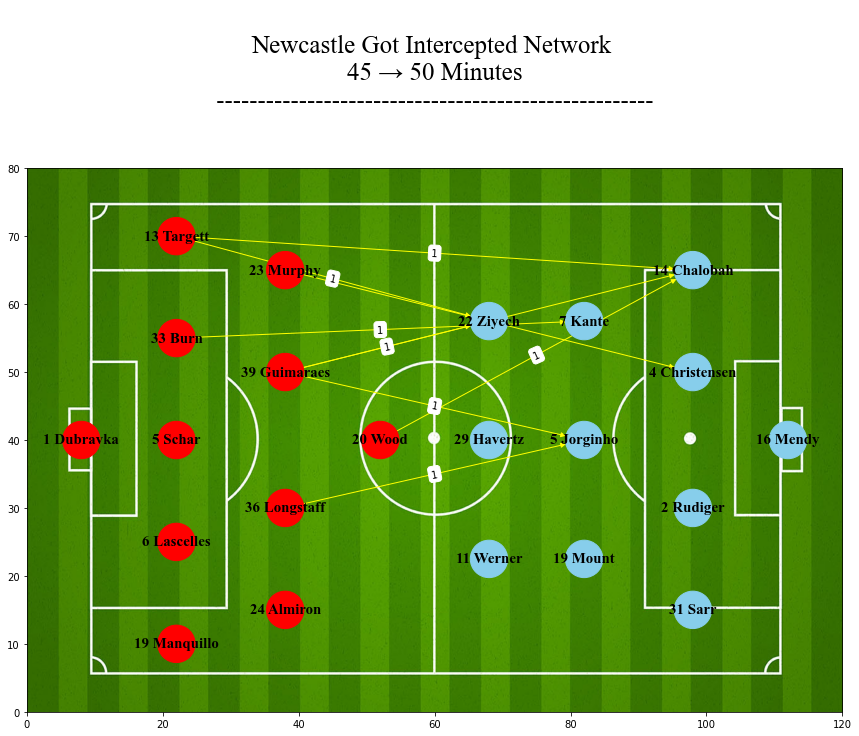


Total number of nodes:  22

Total number of edges:  9


Interception Network Density =  0.01948051948051948

The sum of passes of all Newcastle players only from other Newcastle players (aka successfull passes) = 13

The sum of indegrees of all Chelsea players only from Newcastles players (aka interceptions, Newcastle gave the ball to Chelsea) = 9

Interception Ratio = 9 / 13 = 0.6923076923076923



In [9]:
#Note how the squad nodes switch sides on pitch like players do in soccer
#Note that nodes that have 2 players names separated by hyphen mean that a substitution happend

Whole_Passing_Network (
                            Which_Half = "2nd Half",
                            Time_Interval_String = "45 → 50 Minutes",  
                            Whole_Table_Excel_Index_Row_Start_IncludedinRange = 188,
                            Whole_Table_Excel_Index_Row_End_ExcludedfromRange = 210,
                            Whole_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                            Whole_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Chelsea_Performance_Visualization_and_Measures (
                                                    Which_Half = "2nd Half",
                                                    Time_Interval_String = "45 → 50 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 188,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 199,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 15,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 188,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 199,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Newcastle_Performance_Visualization_and_Measures (    
                                                    Which_Half = "2nd Half",
                                                    Time_Interval_String = "45 → 50 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 199,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 210,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 26,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 199,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 210,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 15)

## **Time Interval (in minutes): 50 → 60**

View of Overall Network



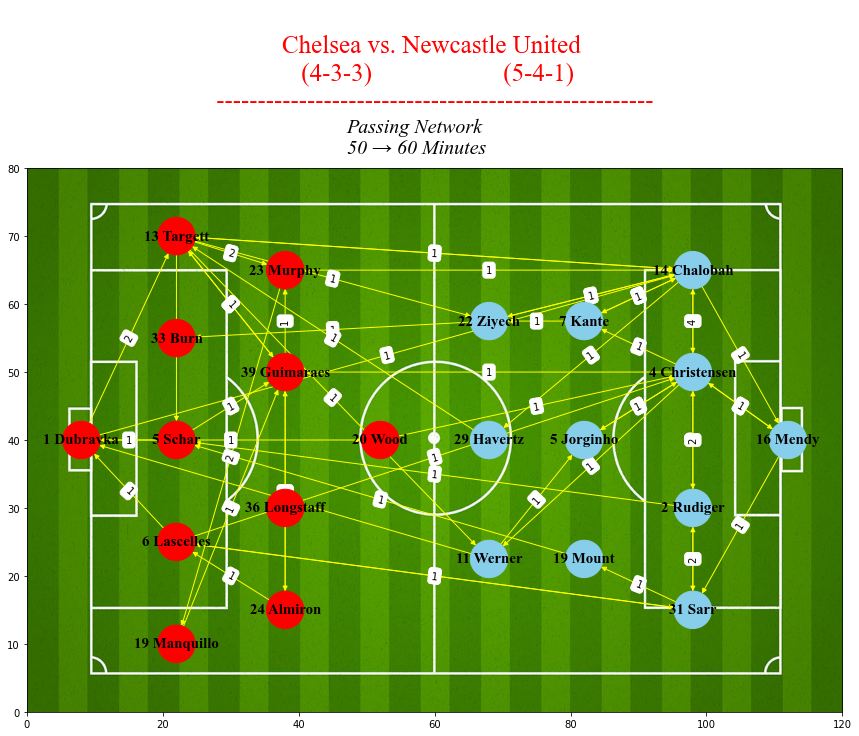


Total number of nodes:  22

Total number of edges:  53
Not to be confused with the total number of interceptions because these edges have weights.

The total number of passes that occured on field throughout this time interval = 66

View of Chelsea's Network



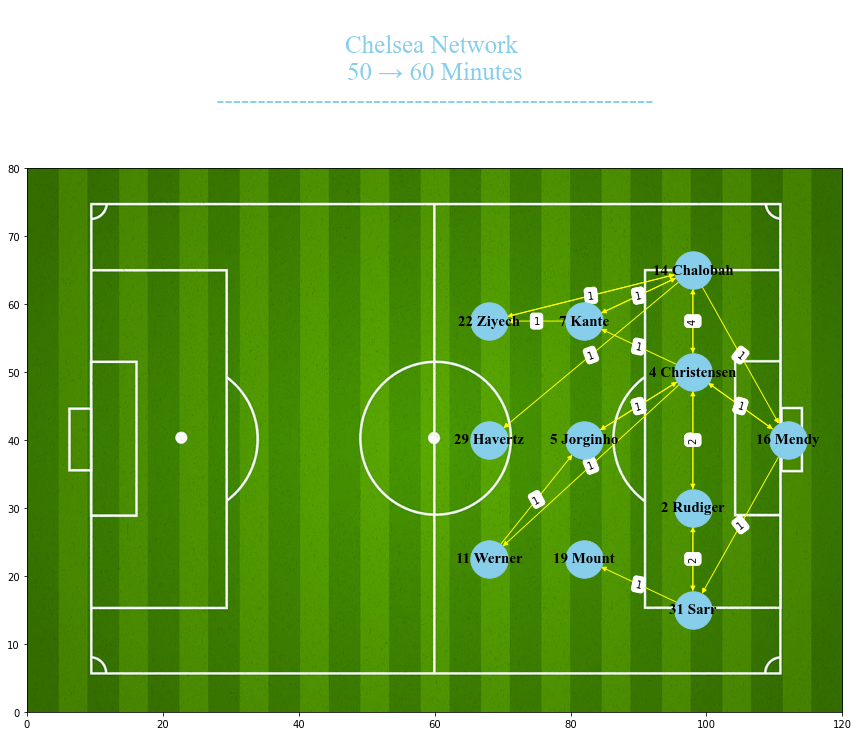


Total number of nodes:  11

Total number of edges:  22


Passing Network Density =  0.2

Player:  4 Christensen  | Degree Centrality:  10
Player:  14 Chalobah  | Degree Centrality:  8
Player:  16 Mendy  | Degree Centrality:  4
Player:  2 Rudiger  | Degree Centrality:  4
Player:  7 Kante  | Degree Centrality:  4
Player:  31 Sarr  | Degree Centrality:  4
Player:  22 Ziyech  | Degree Centrality:  3
Player:  5 Jorginho  | Degree Centrality:  3
Player:  11 Werner  | Degree Centrality:  2
Player:  19 Mount  | Degree Centrality:  1
Player:  29 Havertz  | Degree Centrality:  1

Player:  4 Christensen | Betweenness Centrality:  0.5166666666666667  | Degree:  10
Player:  14 Chalobah | Betweenness Centrality:  0.2888888888888889  | Degree:  8
Player:  2 Rudiger | Betweenness Centrality:  0.12222222222222223  | Degree:  4
Player:  16 Mendy | Betweenness Centrality:  0.1  | Degree:  4
Player:  5 Jorginho | Betweenness Centrality:  0.1  | Degree:  3
Player:  31 Sarr | Betweenness Centrality:  0.094

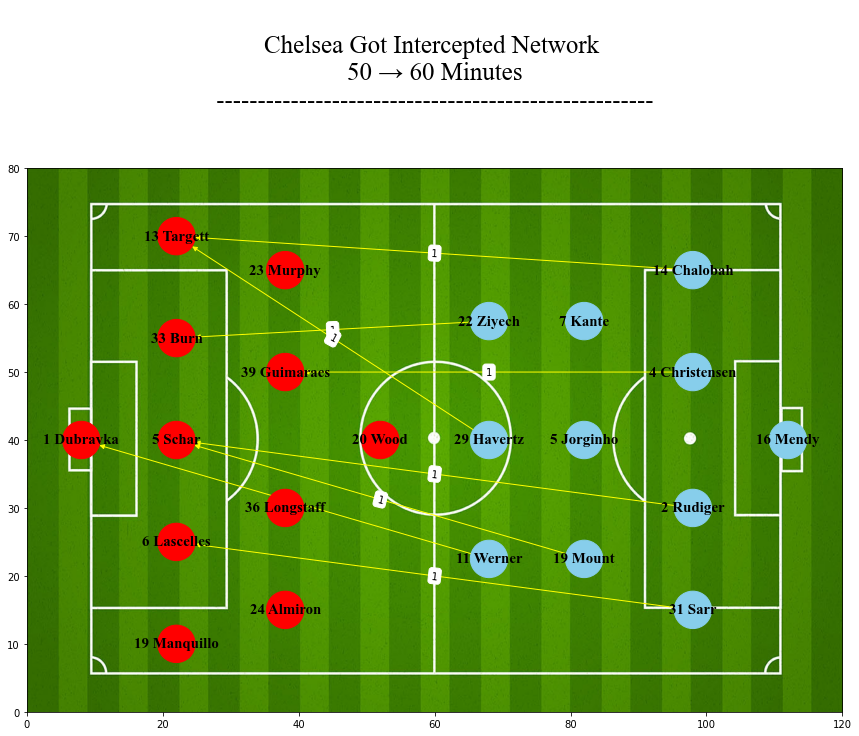


Total number of nodes:  22

Total number of edges:  8


Passing Network Density =  0.017316017316017316

The sum of passes of all Chelsea players only from other Chelsea players (aka successfull passes) = 31

The sum of indegrees of all Newcastle players only from Chelsea players (aka interceptions) = 8

Interception Ratio = 8 / 31 = 0.25806451612903225

View of Newcastle's Network



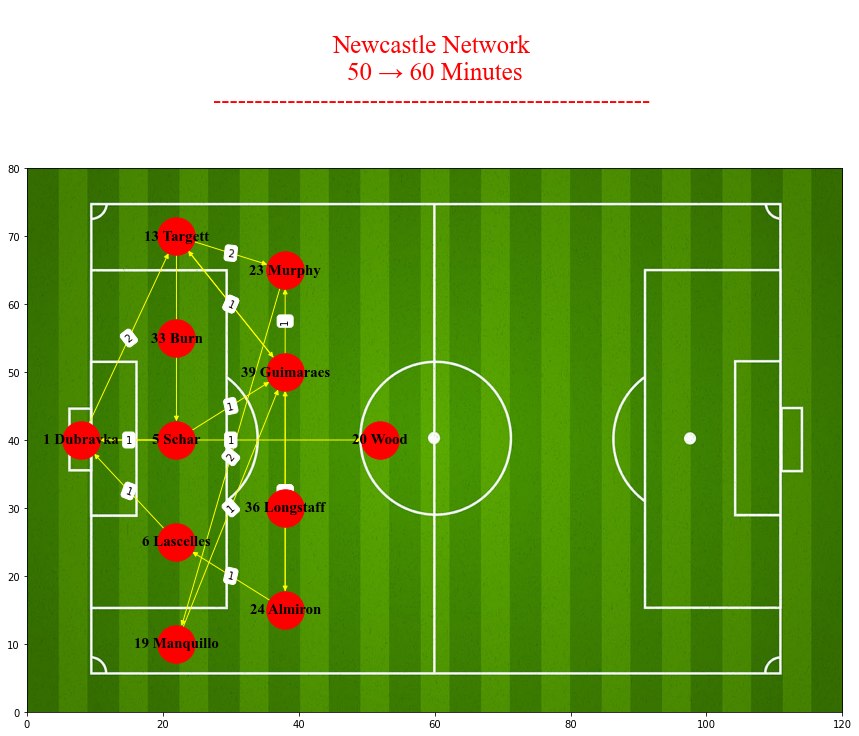


Total number of nodes:  11

Total number of edges:  15


Passing Network Density =  0.13636363636363635

Player:  39 Guimaraes  | Degree Centrality:  7
Player:  13 Targett  | Degree Centrality:  5
Player:  1 Dubravka  | Degree Centrality:  4
Player:  5 Schar  | Degree Centrality:  3
Player:  23 Murphy  | Degree Centrality:  3
Player:  24 Almiron  | Degree Centrality:  3
Player:  6 Lascelles  | Degree Centrality:  2
Player:  19 Manquillo  | Degree Centrality:  2
Player:  20 Wood  | Degree Centrality:  1
Player:  33 Burn  | Degree Centrality:  0
Player:  36 Longstaff  | Degree Centrality:  0

Player:  39 Guimaraes | Betweenness Centrality:  0.29444444444444445  | Degree:  7
Player:  13 Targett | Betweenness Centrality:  0.2  | Degree:  5
Player:  1 Dubravka | Betweenness Centrality:  0.15  | Degree:  4
Player:  24 Almiron | Betweenness Centrality:  0.1  | Degree:  3
Player:  19 Manquillo | Betweenness Centrality:  0.07777777777777778  | Degree:  2
Player:  23 Murphy | Betweenness Centra

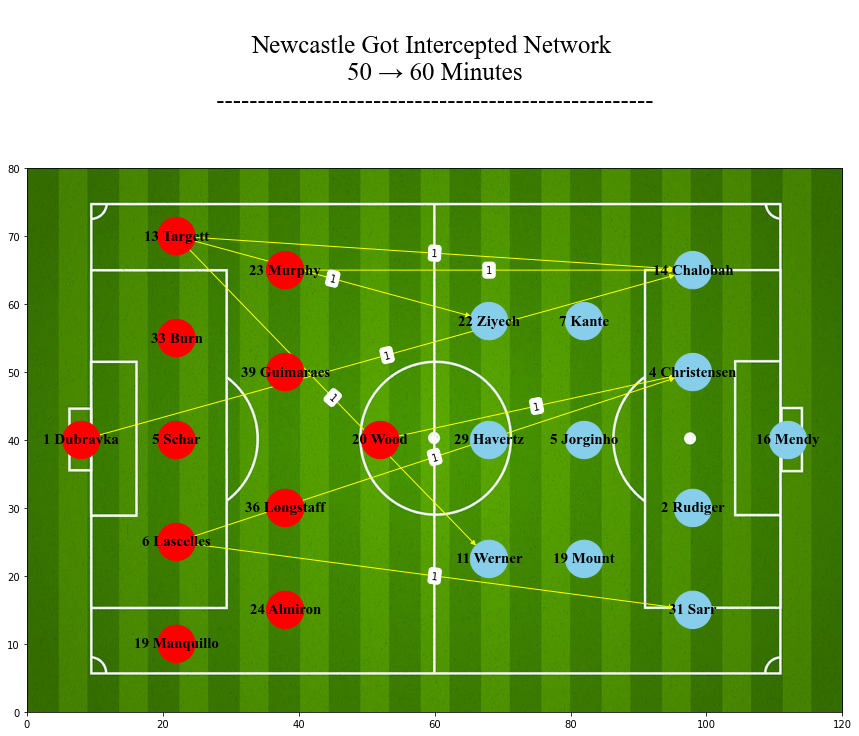


Total number of nodes:  22

Total number of edges:  8


Passing Network Density =  0.017316017316017316

The sum of passes of all Newcastle players only from other Newcastle players (aka successfull passes) = 19

The sum of indegrees of all Chelsea players only from Newcastles players (aka interceptions, Newcastle gave the ball to Chelsea) = 8

Interception Ratio = 8 / 19 = 0.42105263157894735



In [23]:
Whole_Passing_Network (
                            Which_Half = "2nd Half",
                            Time_Interval_String = "50 → 60 Minutes",  
                            Whole_Table_Excel_Index_Row_Start_IncludedinRange = 221,
                            Whole_Table_Excel_Index_Row_End_ExcludedfromRange = 243,
                            Whole_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                            Whole_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Chelsea_Performance_Visualization_and_Measures (
                                                    Which_Half = "2nd Half",
                                                    Time_Interval_String = "50 → 60 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 221,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 232,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 15,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 221,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 232,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Newcastle_Performance_Visualization_and_Measures (    
                                                    Which_Half = "2nd Half",
                                                    Time_Interval_String = "50 → 60 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 232,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 243,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 26,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 232,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 243,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 15)

## **Time Interval (in minutes): 60 → 70**

View of Overall Network



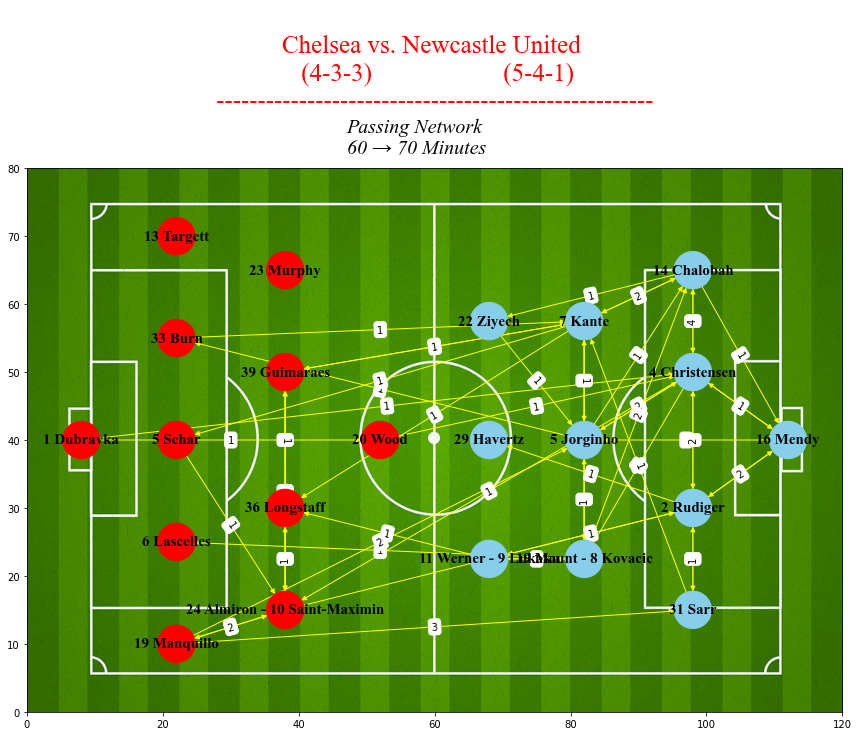


Total number of nodes:  22

Total number of edges:  55
Not to be confused with the total number of interceptions because these edges have weights.

The total number of passes that occured on field throughout this time interval = 84

View of Chelsea's Network



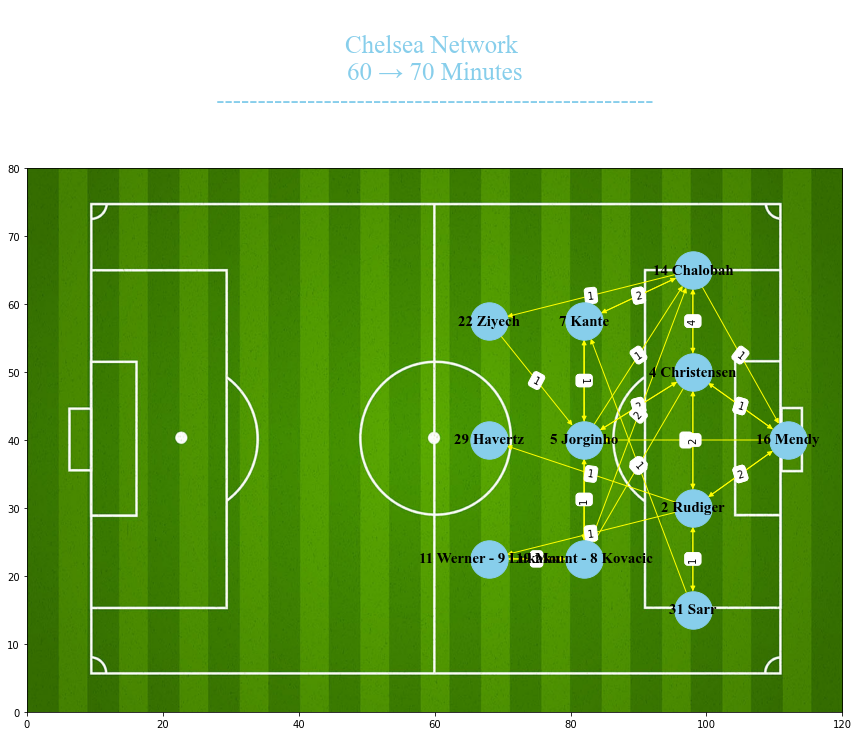


Total number of nodes:  11

Total number of edges:  31


Passing Network Density =  0.2818181818181818

Player:  4 Christensen  | Degree Centrality:  9
Player:  5 Jorginho  | Degree Centrality:  9
Player:  14 Chalobah  | Degree Centrality:  8
Player:  2 Rudiger  | Degree Centrality:  8
Player:  19 Mount - 8 Kovacic  | Degree Centrality:  7
Player:  16 Mendy  | Degree Centrality:  6
Player:  7 Kante  | Degree Centrality:  6
Player:  31 Sarr  | Degree Centrality:  3
Player:  11 Werner - 9 Lukaku  | Degree Centrality:  3
Player:  22 Ziyech  | Degree Centrality:  2
Player:  29 Havertz  | Degree Centrality:  1

Player:  2 Rudiger | Betweenness Centrality:  0.24444444444444446  | Degree:  8
Player:  14 Chalobah | Betweenness Centrality:  0.23333333333333334  | Degree:  8
Player:  4 Christensen | Betweenness Centrality:  0.225  | Degree:  9
Player:  5 Jorginho | Betweenness Centrality:  0.19444444444444445  | Degree:  9
Player:  19 Mount - 8 Kovacic | Betweenness Centrality:  0.1444444444444

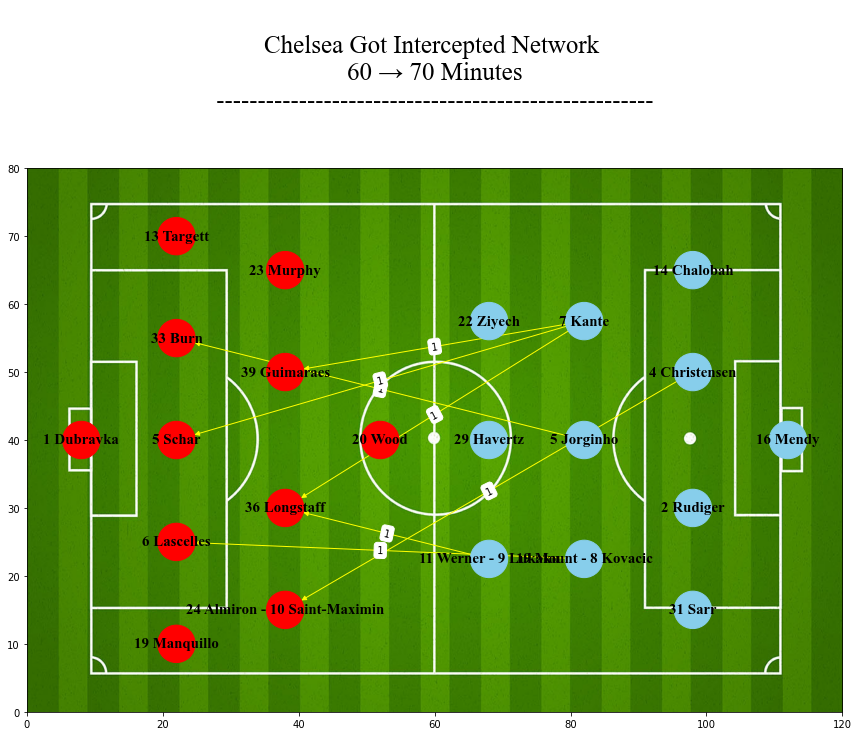


Total number of nodes:  22

Total number of edges:  7


Passing Network Density =  0.015151515151515152

The sum of passes of all Chelsea players only from other Chelsea players (aka successfull passes) = 53

The sum of indegrees of all Newcastle players only from Chelsea players (aka interceptions) = 7

Interception Ratio = 7 / 53 = 0.1320754716981132

View of Newcastle's Network



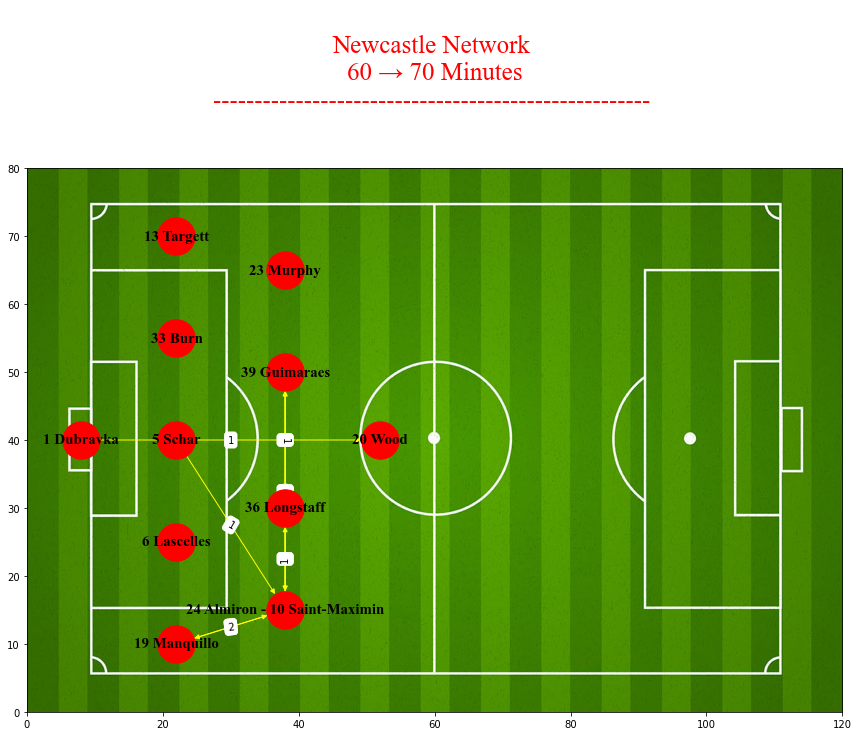


Total number of nodes:  11

Total number of edges:  10


Passing Network Density =  0.09090909090909091

Player:  24 Almiron - 10 Saint-Maximin  | Degree Centrality:  7
Player:  36 Longstaff  | Degree Centrality:  4
Player:  39 Guimaraes  | Degree Centrality:  4
Player:  19 Manquillo  | Degree Centrality:  2
Player:  1 Dubravka  | Degree Centrality:  1
Player:  5 Schar  | Degree Centrality:  1
Player:  20 Wood  | Degree Centrality:  1
Player:  6 Lascelles  | Degree Centrality:  0
Player:  33 Burn  | Degree Centrality:  0
Player:  13 Targett  | Degree Centrality:  0
Player:  23 Murphy  | Degree Centrality:  0

Player:  24 Almiron - 10 Saint-Maximin | Betweenness Centrality:  0.07777777777777778  | Degree:  7
Player:  1 Dubravka | Betweenness Centrality:  0.0  | Degree:  1
Player:  5 Schar | Betweenness Centrality:  0.0  | Degree:  1
Player:  6 Lascelles | Betweenness Centrality:  0.0  | Degree:  0
Player:  33 Burn | Betweenness Centrality:  0.0  | Degree:  0
Player:  19 Manquillo | Bet

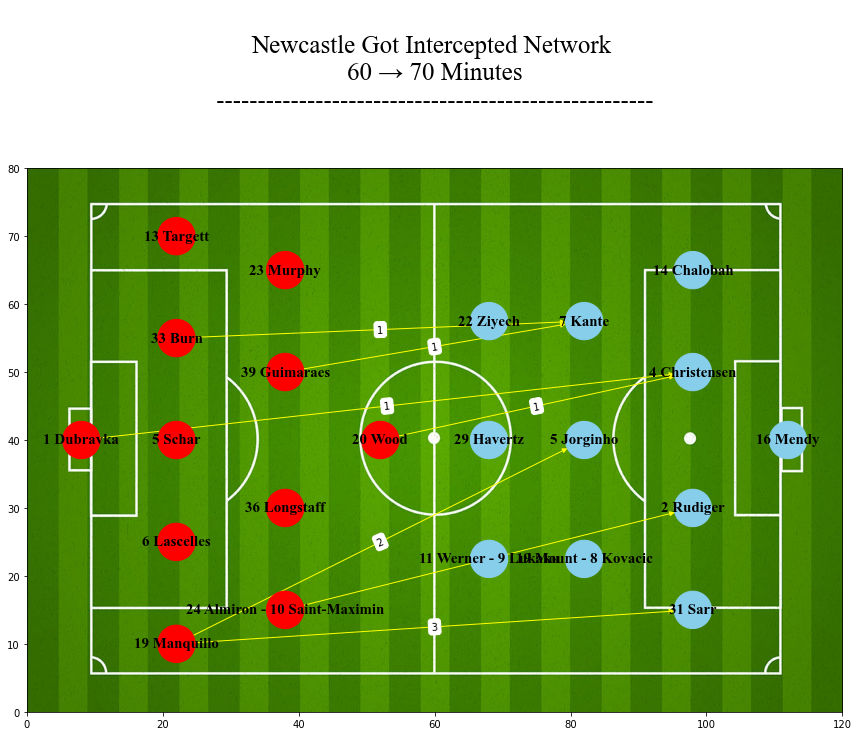


Total number of nodes:  22

Total number of edges:  7


Passing Network Density =  0.015151515151515152

The sum of passes of all Newcastle players only from other Newcastle players (aka successfull passes) = 14

The sum of indegrees of all Chelsea players only from Newcastles players (aka interceptions, Newcastle gave the ball to Chelsea) = 10

Interception Ratio = 10 / 14 = 0.7142857142857143



In [24]:
Whole_Passing_Network (
                            Which_Half = "2nd Half",
                            Time_Interval_String = "60 → 70 Minutes",  
                            Whole_Table_Excel_Index_Row_Start_IncludedinRange = 254,
                            Whole_Table_Excel_Index_Row_End_ExcludedfromRange = 276,
                            Whole_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                            Whole_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Chelsea_Performance_Visualization_and_Measures (
                                                    Which_Half = "2nd Half",
                                                    Time_Interval_String = "60 → 70 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 254,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 265,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 15,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 254,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 265,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Newcastle_Performance_Visualization_and_Measures (    
                                                    Which_Half = "2nd Half",
                                                    Time_Interval_String = "60 → 70 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 265,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 276,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 26,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 265,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 276,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 15)

## **Time Interval (in minutes): 70 → 80**

View of Overall Network



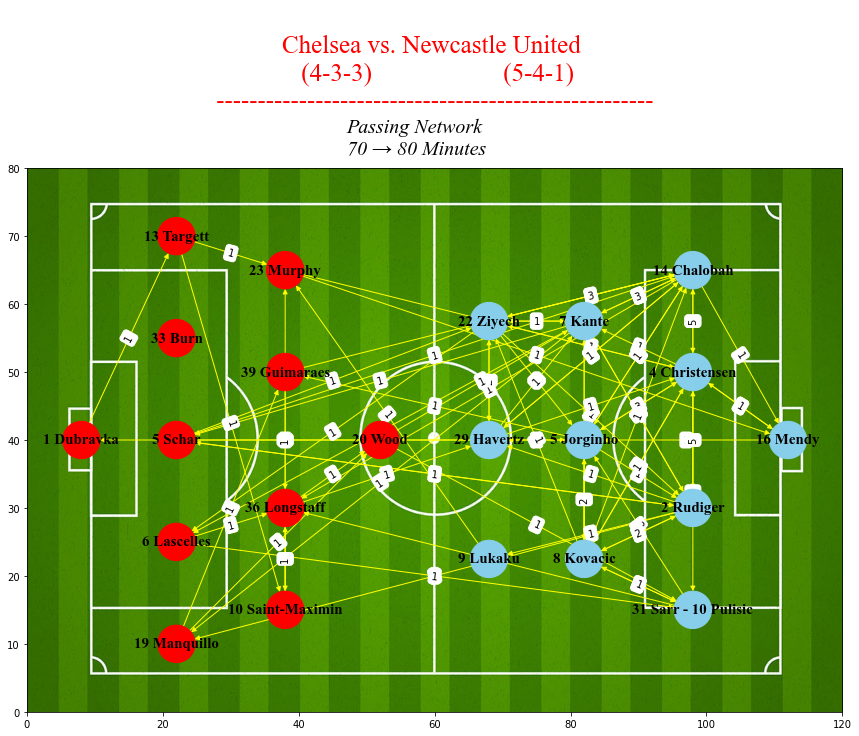


Total number of nodes:  22

Total number of edges:  81
Not to be confused with the total number of interceptions because these edges have weights.

The total number of passes that occured on field throughout this time interval = 122

View of Chelsea's Network



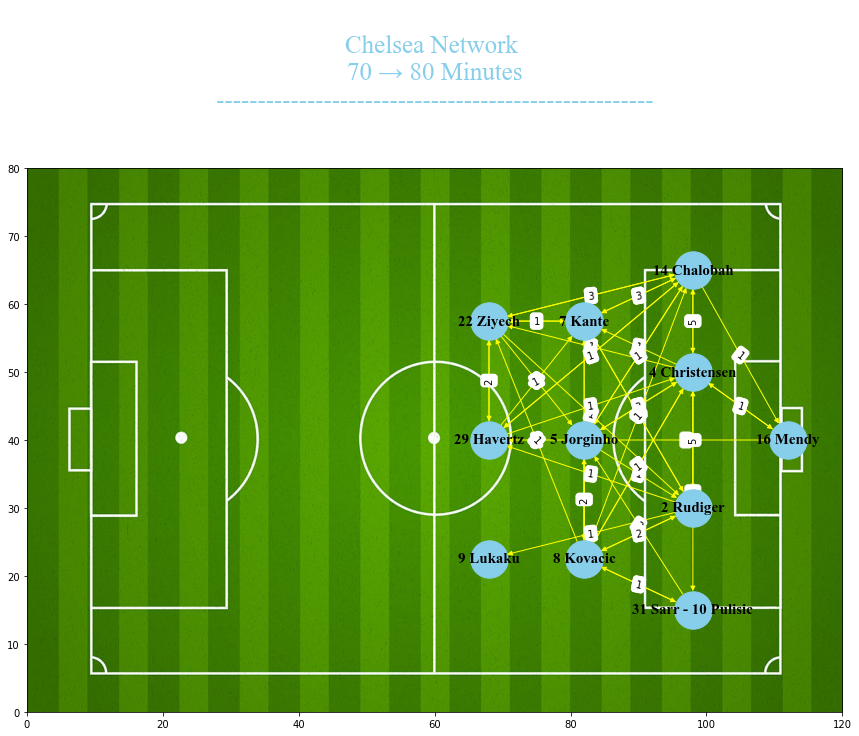


Total number of nodes:  11

Total number of edges:  48


Passing Network Density =  0.43636363636363634

Player:  4 Christensen  | Degree Centrality:  14
Player:  14 Chalobah  | Degree Centrality:  12
Player:  8 Kovacic  | Degree Centrality:  12
Player:  5 Jorginho  | Degree Centrality:  11
Player:  2 Rudiger  | Degree Centrality:  10
Player:  22 Ziyech  | Degree Centrality:  10
Player:  7 Kante  | Degree Centrality:  10
Player:  29 Havertz  | Degree Centrality:  8
Player:  16 Mendy  | Degree Centrality:  4
Player:  31 Sarr - 10 Pulisic  | Degree Centrality:  4
Player:  9 Lukaku  | Degree Centrality:  1

Player:  4 Christensen | Betweenness Centrality:  0.1706084656084656  | Degree:  14
Player:  2 Rudiger | Betweenness Centrality:  0.12484126984126985  | Degree:  10
Player:  8 Kovacic | Betweenness Centrality:  0.1005026455026455  | Degree:  12
Player:  5 Jorginho | Betweenness Centrality:  0.09669312169312169  | Degree:  11
Player:  14 Chalobah | Betweenness Centrality:  0.0741798941

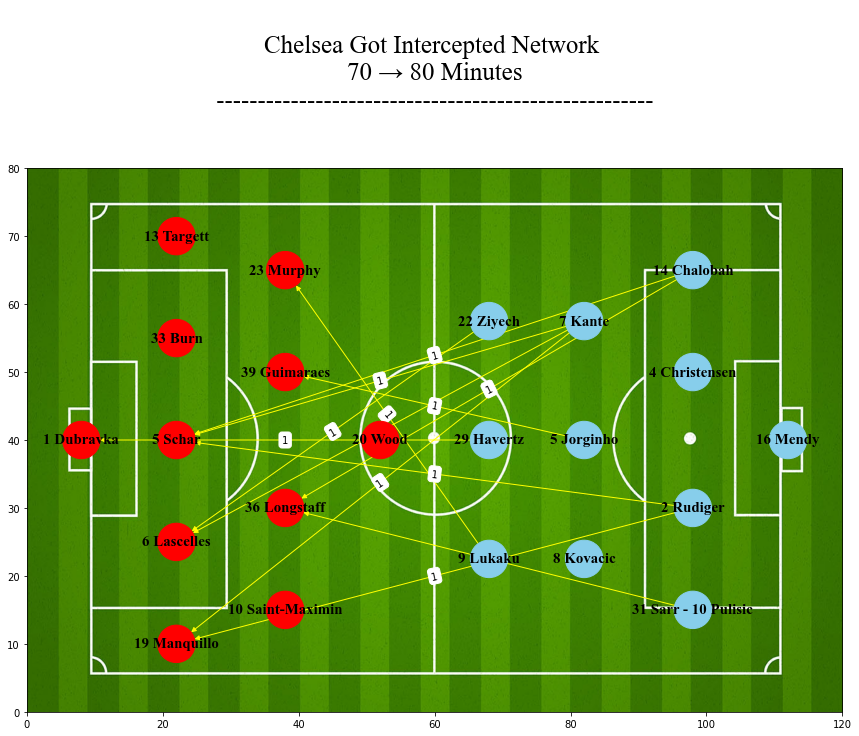


Total number of nodes:  22

Total number of edges:  12


Passing Network Density =  0.025974025974025976

The sum of passes of all Chelsea players only from other Chelsea players (aka successfull passes) = 88

The sum of indegrees of all Newcastle players only from Chelsea players (aka interceptions) = 12

Interception Ratio = 12 / 88 = 0.13636363636363635

View of Newcastle's Network



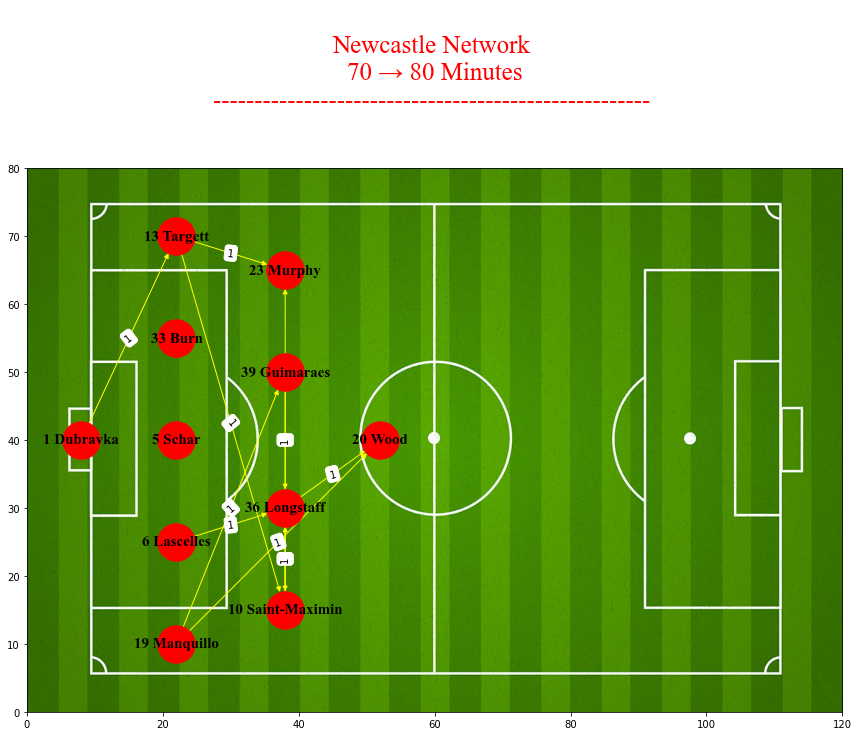


Total number of nodes:  11

Total number of edges:  11


Passing Network Density =  0.1

Player:  36 Longstaff  | Degree Centrality:  5
Player:  10 Saint-Maximin  | Degree Centrality:  4
Player:  13 Targett  | Degree Centrality:  3
Player:  19 Manquillo  | Degree Centrality:  2
Player:  39 Guimaraes  | Degree Centrality:  2
Player:  23 Murphy  | Degree Centrality:  2
Player:  20 Wood  | Degree Centrality:  2
Player:  1 Dubravka  | Degree Centrality:  1
Player:  6 Lascelles  | Degree Centrality:  1
Player:  5 Schar  | Degree Centrality:  0
Player:  33 Burn  | Degree Centrality:  0

Player:  36 Longstaff | Betweenness Centrality:  0.12222222222222223  | Degree:  5
Player:  10 Saint-Maximin | Betweenness Centrality:  0.08888888888888889  | Degree:  4
Player:  13 Targett | Betweenness Centrality:  0.044444444444444446  | Degree:  3
Player:  39 Guimaraes | Betweenness Centrality:  0.03333333333333333  | Degree:  2
Player:  1 Dubravka | Betweenness Centrality:  0.0  | Degree:  1
Player:  5 

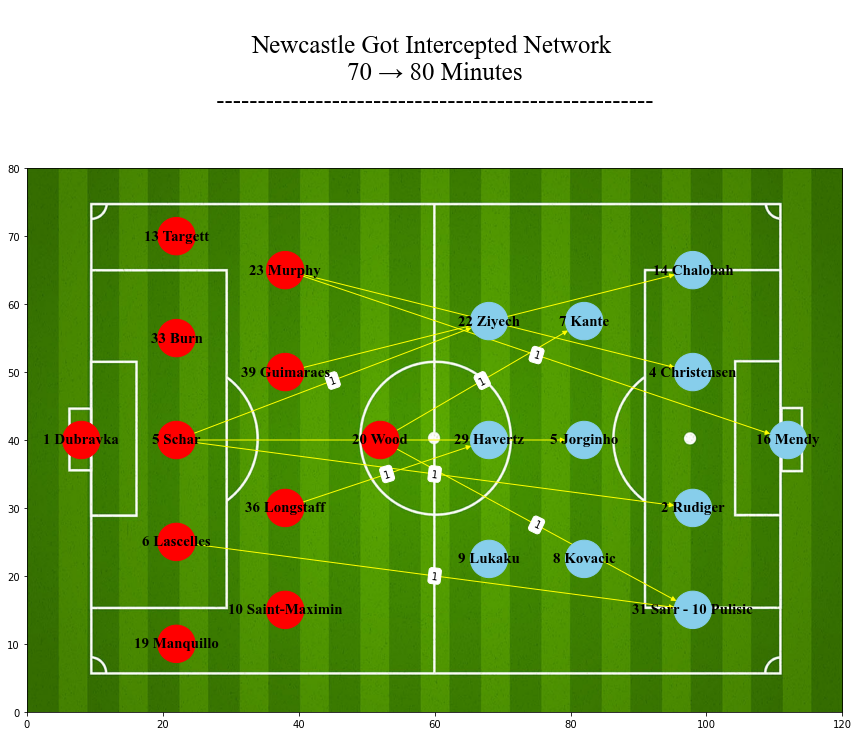


Total number of nodes:  22

Total number of edges:  10


Passing Network Density =  0.021645021645021644

The sum of passes of all Newcastle players only from other Newcastle players (aka successfull passes) = 11

The sum of indegrees of all Chelsea players only from Newcastles players (aka interceptions, Newcastle gave the ball to Chelsea) = 11

Interception Ratio = 11 / 11 = 1.0



In [25]:
Whole_Passing_Network (
                            Which_Half = "2nd Half",
                            Time_Interval_String = "70 → 80 Minutes",  
                            Whole_Table_Excel_Index_Row_Start_IncludedinRange = 287,
                            Whole_Table_Excel_Index_Row_End_ExcludedfromRange = 309,
                            Whole_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                            Whole_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Chelsea_Performance_Visualization_and_Measures (
                                                    Which_Half = "2nd Half",
                                                    Time_Interval_String = "70 → 80 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 287,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 298,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 15,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 287,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 298,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Newcastle_Performance_Visualization_and_Measures (    
                                                    Which_Half = "2nd Half",
                                                    Time_Interval_String = "70 → 80 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 298,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 309,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 26,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 298,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 309,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 15)

## **Time Interval (in minutes): 80 → 90**

View of Overall Network



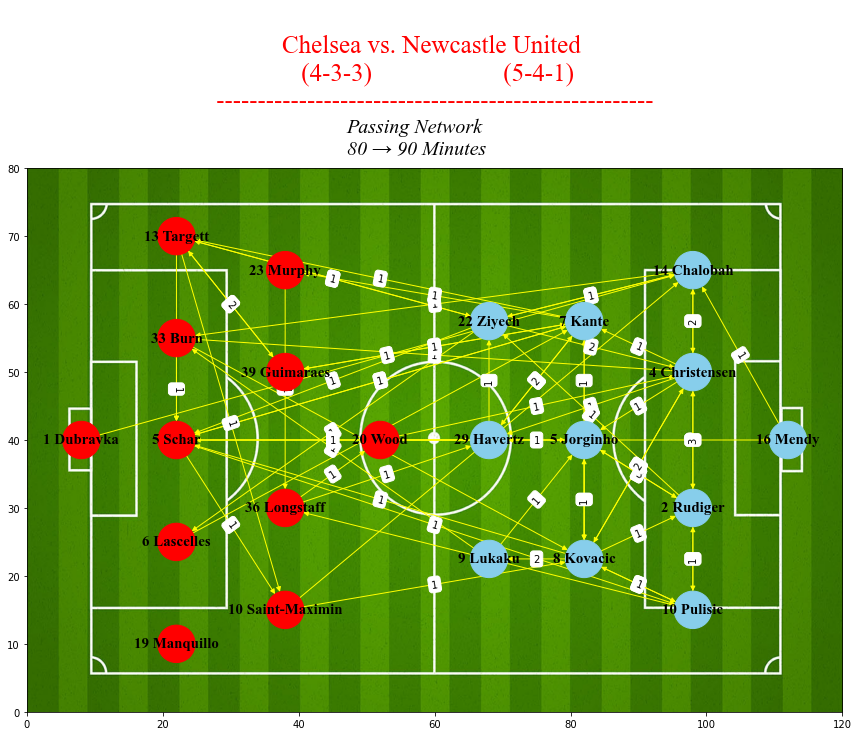


Total number of nodes:  22

Total number of edges:  66
Not to be confused with the total number of interceptions because these edges have weights.

The total number of passes that occured on field throughout this time interval = 84

View of Chelsea's Network



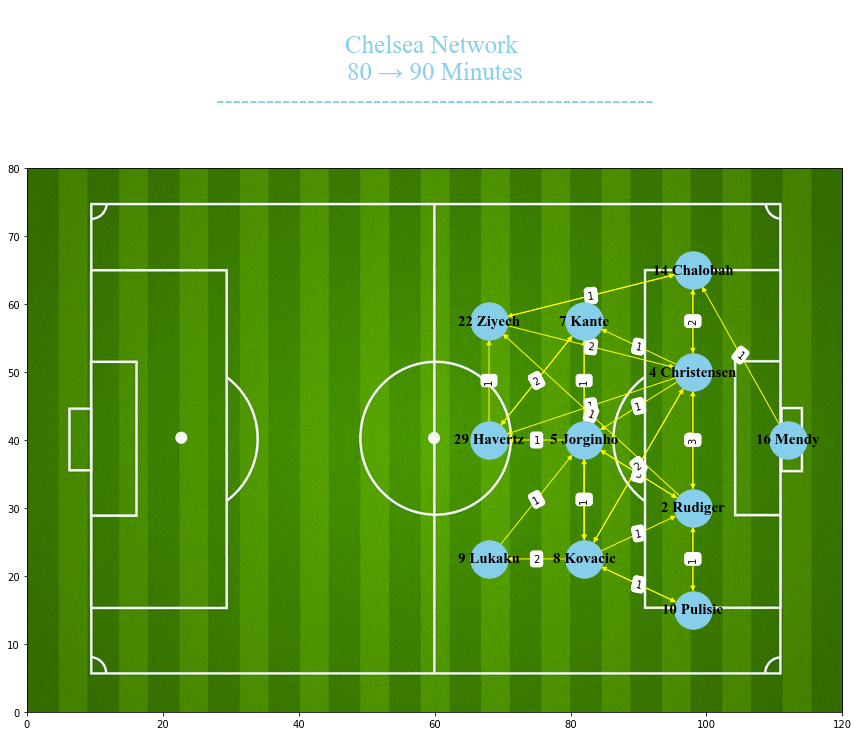


Total number of nodes:  11

Total number of edges:  31


Passing Network Density =  0.2818181818181818

Player:  4 Christensen  | Degree Centrality:  10
Player:  8 Kovacic  | Degree Centrality:  9
Player:  2 Rudiger  | Degree Centrality:  8
Player:  5 Jorginho  | Degree Centrality:  8
Player:  14 Chalobah  | Degree Centrality:  5
Player:  22 Ziyech  | Degree Centrality:  5
Player:  7 Kante  | Degree Centrality:  5
Player:  29 Havertz  | Degree Centrality:  5
Player:  10 Pulisic  | Degree Centrality:  4
Player:  9 Lukaku  | Degree Centrality:  2
Player:  16 Mendy  | Degree Centrality:  1

Player:  4 Christensen | Betweenness Centrality:  0.32592592592592595  | Degree:  10
Player:  8 Kovacic | Betweenness Centrality:  0.24814814814814815  | Degree:  9
Player:  5 Jorginho | Betweenness Centrality:  0.12962962962962962  | Degree:  8
Player:  2 Rudiger | Betweenness Centrality:  0.12222222222222223  | Degree:  8
Player:  14 Chalobah | Betweenness Centrality:  0.10370370370370371  | Degree:

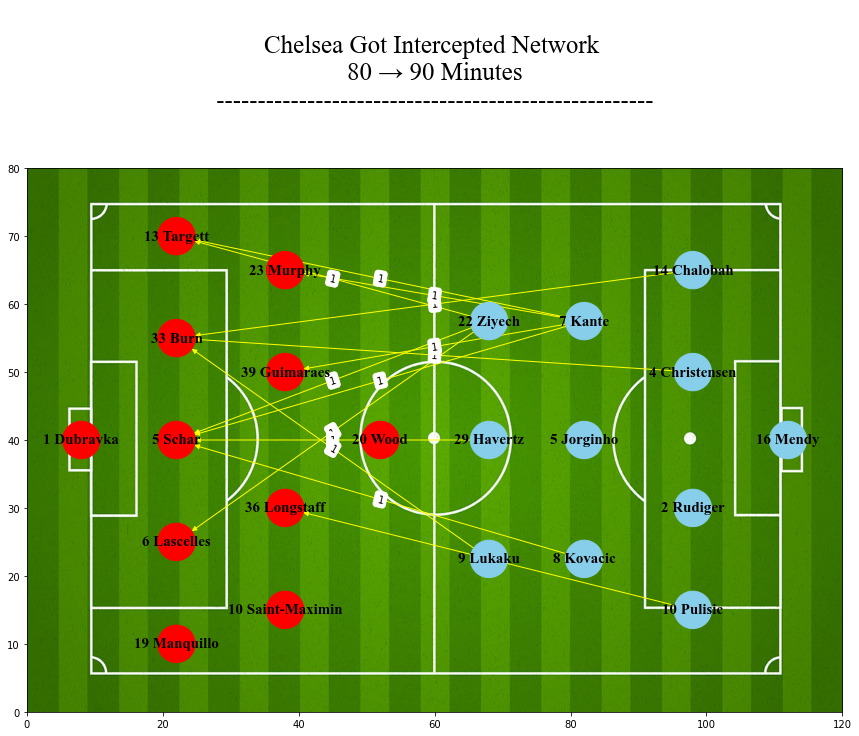


Total number of nodes:  22

Total number of edges:  13


Interception Network Density =  0.02813852813852814

The sum of passes of all Chelsea players only from other Chelsea players (aka successfull passes) = 47

The sum of indegrees of all Newcastle players only from Chelsea players (aka interceptions) = 13

Interception Ratio = 13 / 47 = 0.2765957446808511

View of Newcastle's Network



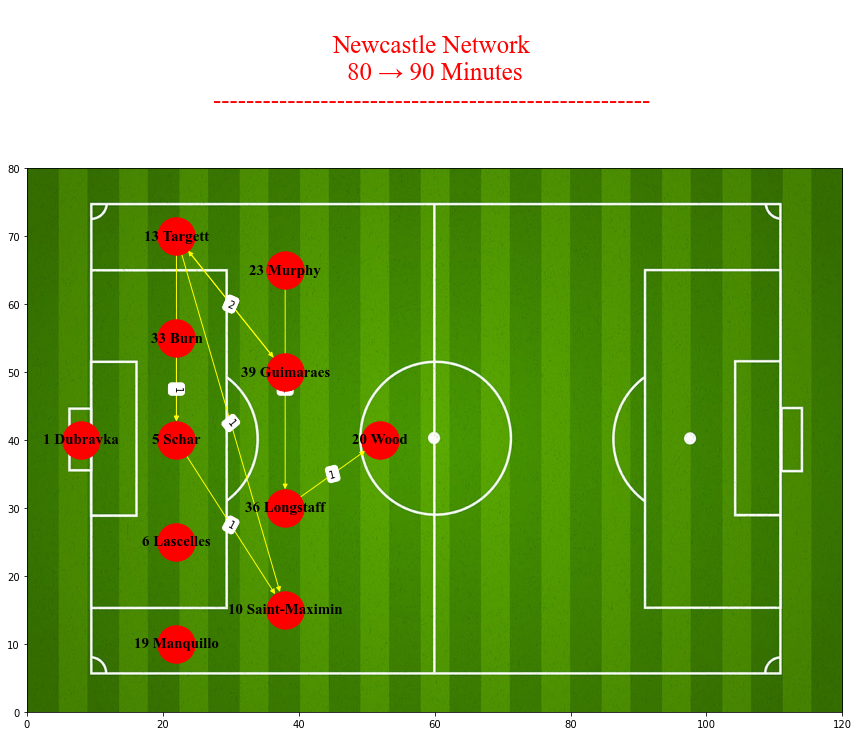


Total number of nodes:  11

Total number of edges:  8


Passing Network Density =  0.07272727272727272

Player:  13 Targett  | Degree Centrality:  4
Player:  5 Schar  | Degree Centrality:  3
Player:  36 Longstaff  | Degree Centrality:  2
Player:  39 Guimaraes  | Degree Centrality:  2
Player:  10 Saint-Maximin  | Degree Centrality:  2
Player:  33 Burn  | Degree Centrality:  1
Player:  23 Murphy  | Degree Centrality:  1
Player:  20 Wood  | Degree Centrality:  1
Player:  1 Dubravka  | Degree Centrality:  0
Player:  6 Lascelles  | Degree Centrality:  0
Player:  19 Manquillo  | Degree Centrality:  0

Player:  13 Targett | Betweenness Centrality:  0.022222222222222223  | Degree:  4
Player:  5 Schar | Betweenness Centrality:  0.011111111111111112  | Degree:  3
Player:  36 Longstaff | Betweenness Centrality:  0.011111111111111112  | Degree:  2
Player:  1 Dubravka | Betweenness Centrality:  0.0  | Degree:  0
Player:  6 Lascelles | Betweenness Centrality:  0.0  | Degree:  0
Player:  33 Burn | B

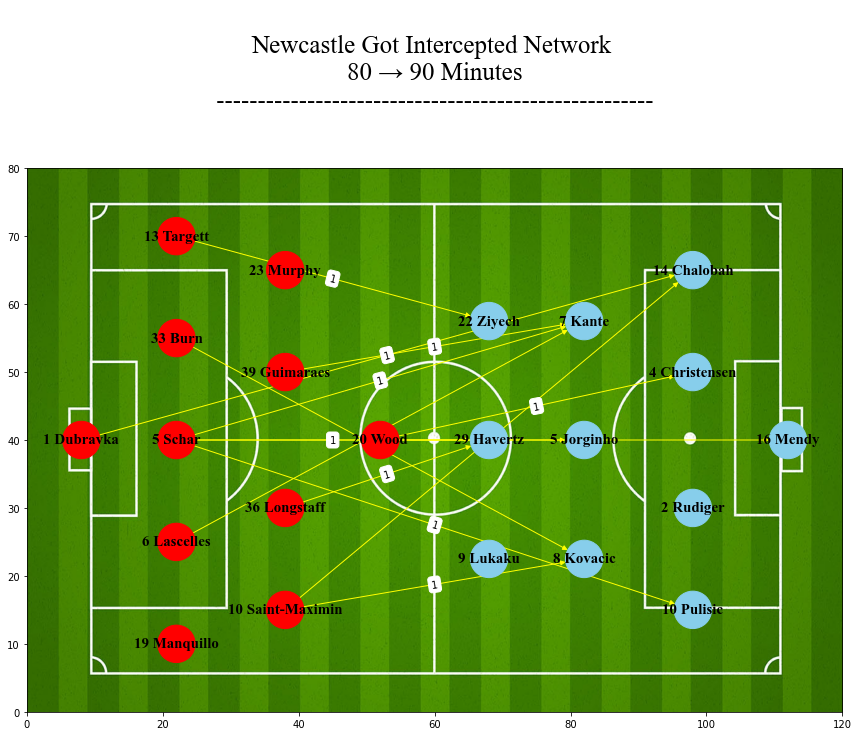


Total number of nodes:  22

Total number of edges:  14


Interception Network Density =  0.030303030303030304

The sum of passes of all Newcastle players only from other Newcastle players (aka successfull passes) = 10

The sum of indegrees of all Chelsea players only from Newcastles players (aka interceptions, Newcastle gave the ball to Chelsea) = 14

Interception Ratio = 14 / 10 = 1.4



In [10]:
Whole_Passing_Network (
                            Which_Half = "2nd Half",
                            Time_Interval_String = "80 → 90 Minutes",  
                            Whole_Table_Excel_Index_Row_Start_IncludedinRange = 320,
                            Whole_Table_Excel_Index_Row_End_ExcludedfromRange = 342,
                            Whole_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                            Whole_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Chelsea_Performance_Visualization_and_Measures (
                                                    Which_Half = "2nd Half",
                                                    Time_Interval_String = "80 → 90 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 320,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 331,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 15,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 320,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 331,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Newcastle_Performance_Visualization_and_Measures (    
                                                    Which_Half = "2nd Half",
                                                    Time_Interval_String = "80 → 90 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 331,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 342,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 26,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 331,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 342,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 15)

## **Time Interval (in minutes): 90 → 94** - (Overtime)

View of Overall Network



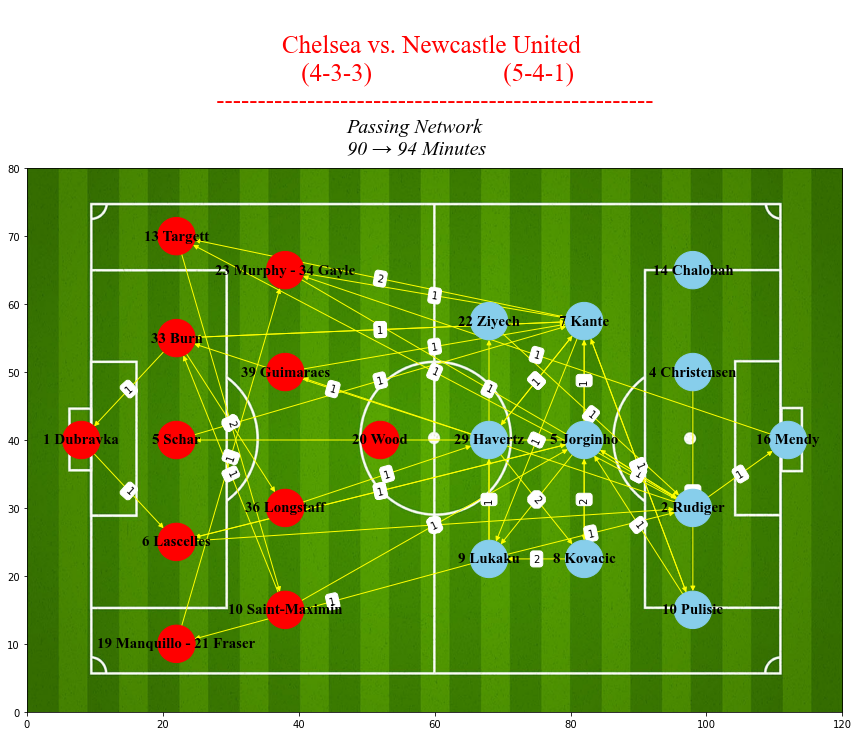


Total number of nodes:  22

Total number of edges:  44
Not to be confused with the total number of interceptions because these edges have weights.

The total number of passes that occured on field throughout this time interval = 50

View of Chelsea's Network



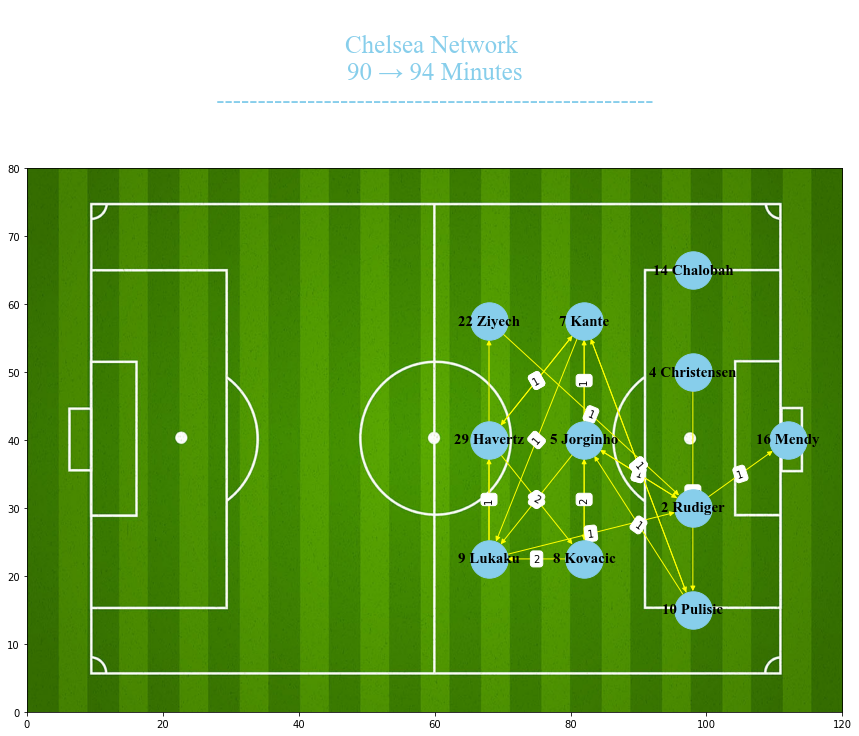


Total number of nodes:  11

Total number of edges:  20


Passing Network Density =  0.18181818181818182

Player:  7 Kante  | Degree Centrality:  7
Player:  5 Jorginho  | Degree Centrality:  6
Player:  9 Lukaku  | Degree Centrality:  6
Player:  2 Rudiger  | Degree Centrality:  5
Player:  10 Pulisic  | Degree Centrality:  4
Player:  8 Kovacic  | Degree Centrality:  4
Player:  29 Havertz  | Degree Centrality:  4
Player:  22 Ziyech  | Degree Centrality:  2
Player:  16 Mendy  | Degree Centrality:  1
Player:  4 Christensen  | Degree Centrality:  1
Player:  14 Chalobah  | Degree Centrality:  0

Player:  5 Jorginho | Betweenness Centrality:  0.22962962962962966  | Degree:  6
Player:  7 Kante | Betweenness Centrality:  0.20185185185185187  | Degree:  7
Player:  2 Rudiger | Betweenness Centrality:  0.16666666666666669  | Degree:  5
Player:  9 Lukaku | Betweenness Centrality:  0.1537037037037037  | Degree:  6
Player:  10 Pulisic | Betweenness Centrality:  0.09444444444444444  | Degree:  4
Player

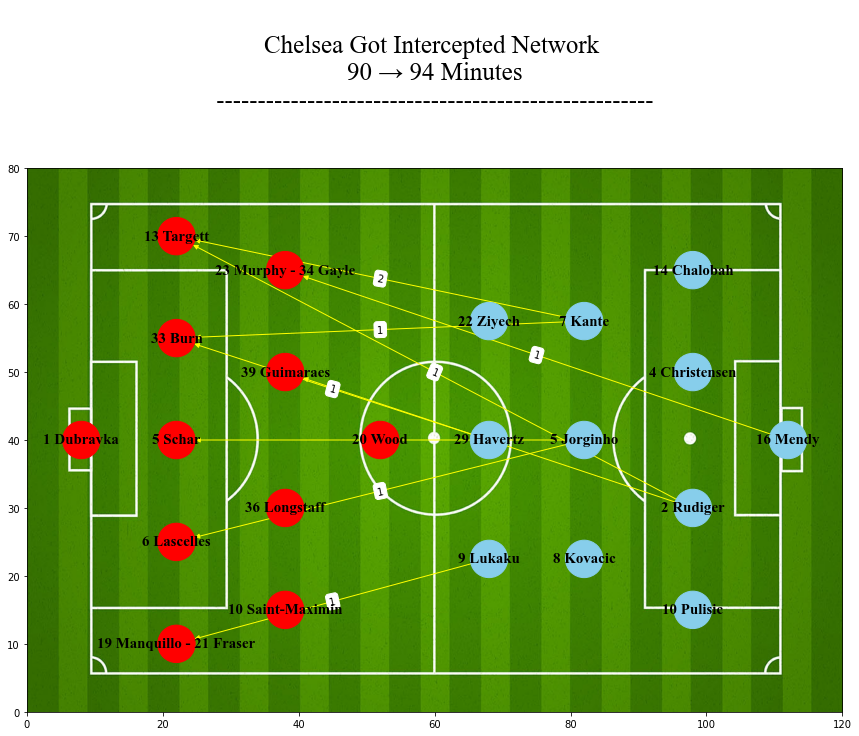


Total number of nodes:  22

Total number of edges:  9


Passing Network Density =  0.01948051948051948

The sum of passes of all Chelsea players only from other Chelsea players (aka successfull passes) = 24

The sum of indegrees of all Newcastle players only from Chelsea players (aka interceptions) = 10

Interception Ratio = 10 / 24 = 0.4166666666666667

View of Newcastle's Network



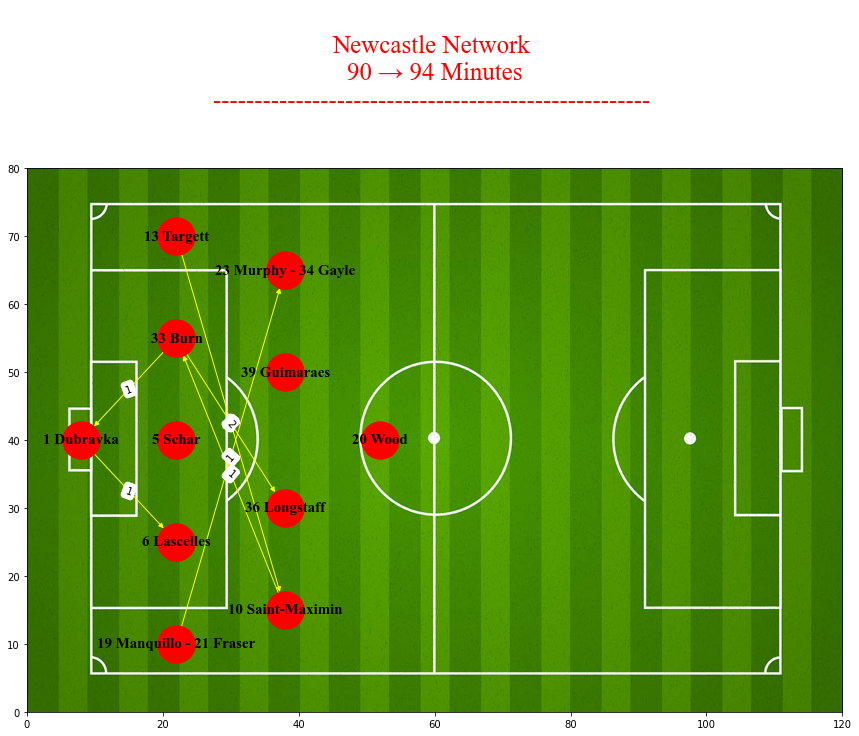


Total number of nodes:  11

Total number of edges:  6


Passing Network Density =  0.05454545454545454

Player:  33 Burn  | Degree Centrality:  3
Player:  1 Dubravka  | Degree Centrality:  2
Player:  10 Saint-Maximin  | Degree Centrality:  2
Player:  6 Lascelles  | Degree Centrality:  1
Player:  19 Manquillo - 21 Fraser  | Degree Centrality:  1
Player:  36 Longstaff  | Degree Centrality:  1
Player:  13 Targett  | Degree Centrality:  1
Player:  23 Murphy - 34 Gayle  | Degree Centrality:  1
Player:  5 Schar  | Degree Centrality:  0
Player:  39 Guimaraes  | Degree Centrality:  0
Player:  20 Wood  | Degree Centrality:  0

Player:  33 Burn | Betweenness Centrality:  0.06666666666666667  | Degree:  3
Player:  10 Saint-Maximin | Betweenness Centrality:  0.044444444444444446  | Degree:  2
Player:  1 Dubravka | Betweenness Centrality:  0.03333333333333333  | Degree:  2
Player:  5 Schar | Betweenness Centrality:  0.0  | Degree:  0
Player:  6 Lascelles | Betweenness Centrality:  0.0  | Degree:  

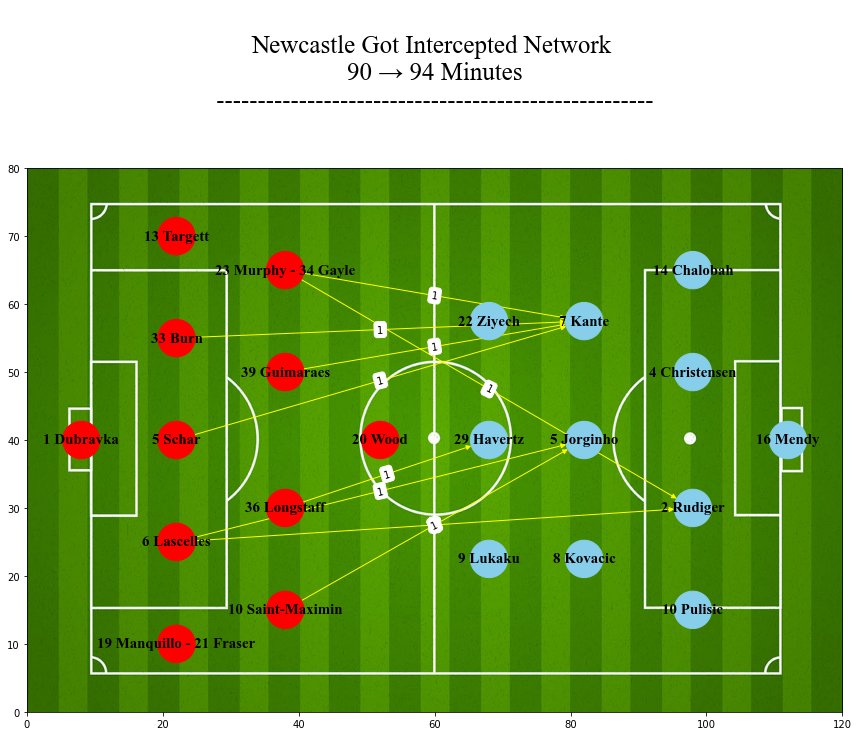


Total number of nodes:  22

Total number of edges:  9


Passing Network Density =  0.01948051948051948

The sum of passes of all Newcastle players only from other Newcastle players (aka successfull passes) = 7

The sum of indegrees of all Chelsea players only from Newcastles players (aka interceptions, Newcastle gave the ball to Chelsea) = 9

Interception Ratio = 9 / 7 = 1.2857142857142858



In [27]:
Whole_Passing_Network (
                            Which_Half = "2nd Half",
                            Time_Interval_String = "90 → 94 Minutes",  
                            Whole_Table_Excel_Index_Row_Start_IncludedinRange = 353,
                            Whole_Table_Excel_Index_Row_End_ExcludedfromRange = 375,
                            Whole_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                            Whole_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Chelsea_Performance_Visualization_and_Measures (
                                                    Which_Half = "2nd Half",
                                                    Time_Interval_String = "90 → 94 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 353,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 364,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 15,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 353,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 364,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 26)

Newcastle_Performance_Visualization_and_Measures (    
                                                    Which_Half = "2nd Half",
                                                    Time_Interval_String = "90 → 94 Minutes",
                                                    Passing_Table_Excel_Index_Row_Start_IncludedinRange = 364,
                                                    Passing_Table_Excel_Index_Row_End_ExcludedfromRange = 375,
                                                    Passing_Table_Excel_Index_Column_Start_IncludedinRange = 15,
                                                    Passing_Table_Excel_Index_Column_End_ExcludedfromRange = 26,
                                                    Interception_Table_Excel_Index_Row_Start_IncludedinRange = 364,
                                                    Interception_Table_Excel_Index_Row_End_ExcludedfromRange = 375,
                                                    Interception_Table_Excel_Index_Column_Start_IncludedinRange = 4,
                                                    Interception_Table_Excel_Index_Column_End_ExcludedfromRange = 15)